# <font color = red> **<span style="font-size: 48px;">Eye for Blind</span>**

Deep learning solution for generating image captions with speech output to assist visually impaired individuals in understanding visual content.

- Github repo:- https://github.com/Saurabh4Dev/EyeForBlind
- Readme: https://github.com/Saurabh4Dev/EyeForBlind/blob/main/README.md
- Report: https://github.com/Saurabh4Dev/EyeForBlind/blob/main/EyeForBlind_SaurabhPandey_ProjectReport.pdf




## <font color = red> **Project Overview**

### <font color = red> **Problem Statement**

This project aims to assist visually impaired people by building a deep learning model that can describe images in speech. Using a CNN-RNN architecture with an attention mechanism, the model generates captions for images and converts them to audio using text-to-speech. The solution enables blind users to understand image content, similar to Facebook’s accessibility feature.

### <font color = red> **System Design**
- CNN-RNN Architecture with Attention
- Search Strategies (Greedy Search)
- Text-to-Speech Integration
- Comprehensive BLEU Score Evaluation
- Attention Visualization

This project aims to develop an AI system that describes images through speech, enabling visually impaired individuals to understand visual content.
Using the Flickr8k dataset, the model generates captions for images via a CNN and RNN architecture with an attention mechanism.

The CNN (Convolutional Neural Network) acts as an encoder, extracting key image features.

The RNN (Recurrent Neural Network) serves as a decoder, generating descriptive text (captions) word by word, guided by the attention layer to focus on relevant image regions.

The generated text is then converted to audio output using a text-to-speech (TTS) library.

The project integrates Deep Learning (Computer Vision + NLP) to build an assistive system that translates images into spoken descriptions.

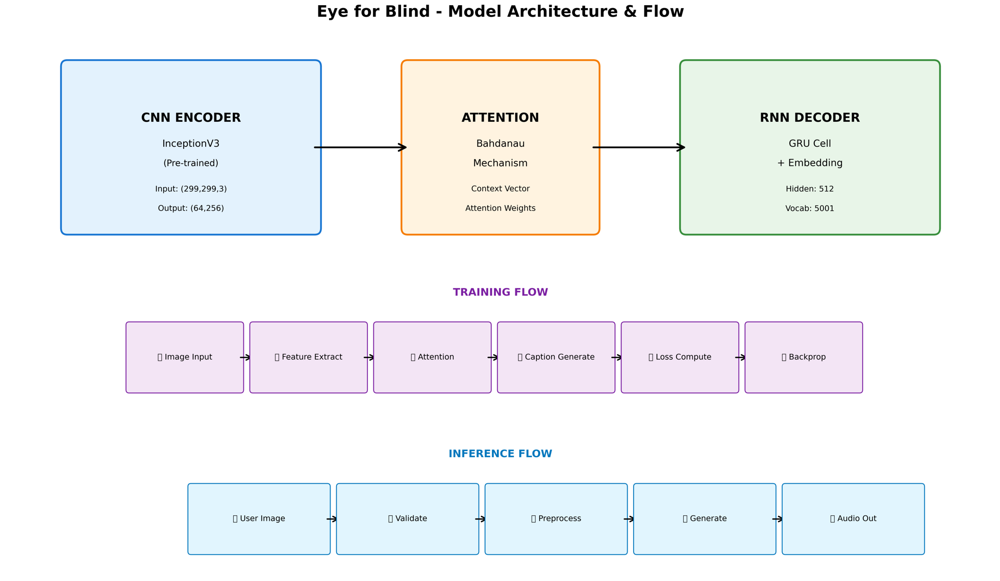

### <font color = red> **Implementation Summary**

This project implements an image captioning model with attention and text-to-speech output. The key steps are:

1.  **Data Loading and Preprocessing**:
    *   Flickr8k dataset images and captions are loaded.
    *   Captions are preprocessed: tokenized, filtered, and padded.
    *   Images are resized and preprocessed for the InceptionV3 model.
    *   Image features are extracted using a pre-trained InceptionV3 model to save memory and computational time.
    *   Image paths and captions are split into training and testing sets.
    *   A data pipeline using `tf.data.Dataset` is created to efficiently load image features and captions in batches.

2.  **Model Architecture**:
    *   An **Encoder** (CNN\_Custom\_Encoder) uses a fully connected layer to process the extracted image features.
    *   An **Attention** mechanism (BahdanauAttention) calculates the attention weights, allowing the model to focus on relevant parts of the image during caption generation. Different attention mechanisms (Luong, Dot-Product) were also defined.
    *   A **Decoder** (RNN\_Custom\_Decoder) uses a GRUCell and an Embedding layer to generate captions word by word, using the context vector from the attention mechanism and the previous word.

3.  **Training and Optimization**:
    *   The model is trained using the Adam optimizer and Sparse Categorical Crossentropy loss with masking for padded sequences.
    *   Teacher forcing is applied during training to guide the decoder with the true next word.
    *   Early stopping is implemented to monitor test loss and prevent overfitting, saving the best model checkpoint.
    *   Training progress and loss curves are visualized.

4.  **Model Evaluation and Prediction**:
    *   A greedy search function is defined to generate captions for new images.
    *   The BLEU score is used to evaluate the quality of the generated captions against the real captions, with different weightings for n-grams.
    *   A function is created to convert the generated captions into audio using gTTS.
    *   Attention maps are visualized to show which parts of the image the model is focusing on for each word in the generated caption.

## <font color = red> **Data preparation**

### <font color = red> **Data and Libraries**

<font color = red> **Install**

In [ ]:
# Install Google text to speech library
!pip install gTTS

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<font color = red> **Import**

In [ ]:
#Import all the required libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import cv2
import glob
import time
import tensorflow as tf
import keras
import nltk
import os
import warnings
import logging

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
from keras.applications.inception_v3 import preprocess_input
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.preprocessing.text import Tokenizer
from keras import Input, layers
from nltk.translate.bleu_score import sentence_bleu
from typing import Tuple, List, Dict, Optional
from IPython.display import Audio, display
from PIL import Image
from collections import Counter
from nltk.corpus import stopwords
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tqdm import tqdm
from gtts import gTTS
from IPython.display import Audio
from google.colab import drive

In [ ]:
nltk.download('stopwords')
# connect to google drive
drive.mount('/content/drive')
# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

### <font color = red> **Data understanding**
1.Import the dataset and read image & captions into two seperate variables

2.Visualise both the images & text present in the dataset

3.Create a dataframe which summarizes the image, path & captions as a dataframe

4.Create a list which contains all the captions & path

5.Visualise the top 30 occuring words in the captions



In [ ]:
# Path variables
images='/content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/Images'
text_file = '/content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/captions.txt'
audio_output_path = '/content/drive/MyDrive/Capstone_EyeForBlind/audio_outputs'

In [ ]:
#Import the dataset and read the image

# Verify image paths exist and display configuration
if os.path.exists(images):
    print("Images directory found")
    print(f"Images directory: {images}")
else:
    print("Images directory not found. Please update the path.")

Images directory found
Images directory: /content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/Images
Captions file found
Captions file: /content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/captions.txt


In [ ]:
# Verify captions paths exist and display configuration
if os.path.exists(text_file):
    print("Captions file found")
    print(f"Captions file: {text_file}")
else:
    print("Captions file not found. Please update the path.")

In [ ]:

# Import the image dataset and read the image into a separate variable
all_imgs = glob.glob(images + '/*.jpg', recursive=True)
print(f"Image directory being used: {images}")
print("The total images present in the dataset: {}".format(len(all_imgs)))

# Check if images exists
if len(all_imgs) == 0:
    print("No images found! Please check the images path.")
else:
    print(f"Successfully found {len(all_imgs)} images")

Image directory being used: /content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/Images
The total images present in the dataset: 8091
Successfully found 8091 images


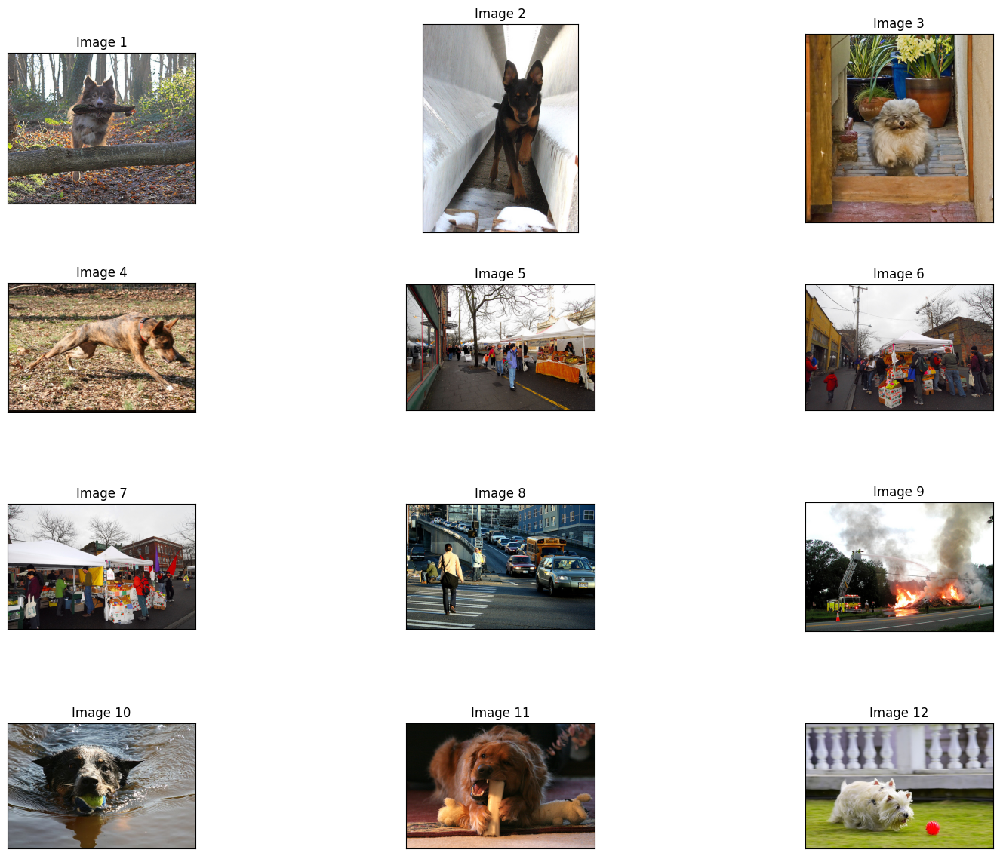

In [ ]:
# Visualize both the images & text present in the dataset

# Images
num_rows = 4
num_cols = 3
num_imgs = num_rows * num_cols
plt.figure(figsize=(16, 12))

for i in range(min(num_imgs, len(all_imgs))):
    plt.subplot(num_rows, 2*num_cols, 2*i+1)
    plt.xticks([])
    plt.yticks([])
    try:
        plt.imshow(mpimg.imread(all_imgs[i]))
        plt.title(f"Image {i+1}")
    except Exception as e:
        print(f"Error loading image {i+1}: {e}")

plt.tight_layout()
plt.show()

In [ ]:
# Load captions dataframe
try:
    image_captions_df = pd.read_csv(text_file)
    print("Captions loaded successfully")
    print(f"Dataframe shape: {image_captions_df.shape}")
    display(image_captions_df.head())
except Exception as e:
    print(f"Error loading captions: {e}")

Captions loaded successfully
Dataframe shape: (40455, 2)


,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [ ]:
#Import the dataset and read the text file into a seperate variable

# Import the dataset and read the text file into a separate variable

def load_doc(filename):
    """
    Load and parse the captions file.

    Args:
        filename (str): Path to the captions file

    Returns:
        list: List of [image_name, caption] pairs
    """
    try:
        file = open(filename, 'r')
        text = list(filter(None, (line.rstrip() for line in file)))
        file.close()

        lst_line = []
        for line in text:
            lst_line.append(line.split(',', maxsplit=1))
        return lst_line
    except Exception as e:
        print(f"Error loading document: {e}")
        return []

# Using the provided path for the text file
print(f"Text file being used: {text_file}")
doc = load_doc(text_file)

if doc:
    print(f"Successfully loaded {len(doc)} caption entries")
    print("Sample entries:")
    for i, entry in enumerate(doc[:5]):
        print(f"   {i}: {entry}")
else:
    print("Failed to load captions")

# Contents presented is Image(JPG format) name and its captions in list format
# Showing only first few captions and images

Text file being used: /content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/captions.txt
Successfully loaded 40456 caption entries
Sample entries:
   0: ['image', 'caption']
   1: ['1000268201_693b08cb0e.jpg', 'A child in a pink dress is climbing up a set of stairs in an entry way .']
   2: ['1000268201_693b08cb0e.jpg', 'A girl going into a wooden building .']
   3: ['1000268201_693b08cb0e.jpg', 'A little girl climbing into a wooden playhouse .']
   4: ['1000268201_693b08cb0e.jpg', 'A little girl climbing the stairs to her playhouse .']


Create a dataframe which summarizes the image, path & captions as a dataframe

Each image id has 5 captions associated with it therefore the total dataset should have 40455 samples.

In [ ]:
# Create Pandas dataframe
if doc:
    all_img_id = [i[0] for i in doc[1:]]     # store all the image id here
    all_img_vector = ['/content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/Images/'+ i[0] for i in doc[1:]] # store all the image path
    annotations = [i[1] for i in doc[1:]]  # store all the captions

    df = pd.DataFrame(list(zip(all_img_id, all_img_vector, annotations)), columns=['ID', 'Path', 'Captions'])

    print(f"Created dataframe with {len(df)} entries")
    print(f"\n Dataset Statistics:")
    print(f"1. Total image-caption pairs: {len(df)}")
    print(f"2. Unique images: {len(df['ID'].unique())}")
    print(f"3. Average caption length: {df['Captions'].str.len().mean():.1f} characters")
    print(df.info())
else:
    print("No caption data loaded")

# 40455 image and caption pairs loaded as for each Image 5 captions exists=> 8091*5 = 40455.
#  40456 caption entries from captions.txt loaded from which one is Header

Created dataframe with 40455 entries
Dataset Statistics:
1. Total image-caption pairs: 40455
2. Unique images: 8091
3. Average caption length: 55.3 characters
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   ID        40455 non-null  object
 1   Path      40455 non-null  object
 2   Captions  40455 non-null  object
dtypes: object(3)
memory usage: 948.3+ KB
None


,ID,Path,Captions
0,1000268201_693b08cb0e.jpg,/content/drive/MyDrive/Capstone_EyeForBlind/fl...,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,/content/drive/MyDrive/Capstone_EyeForBlind/fl...,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,/content/drive/MyDrive/Capstone_EyeForBlind/fl...,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,/content/drive/MyDrive/Capstone_EyeForBlind/fl...,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,/content/drive/MyDrive/Capstone_EyeForBlind/fl...,A little girl in a pink dress going into a woo...


<font color = red> **Visualize Image with captions**

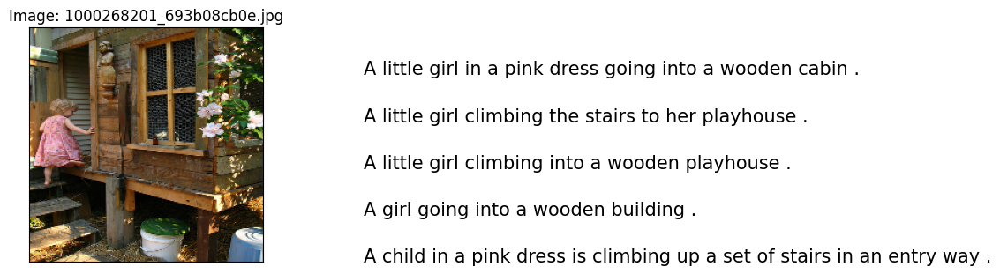

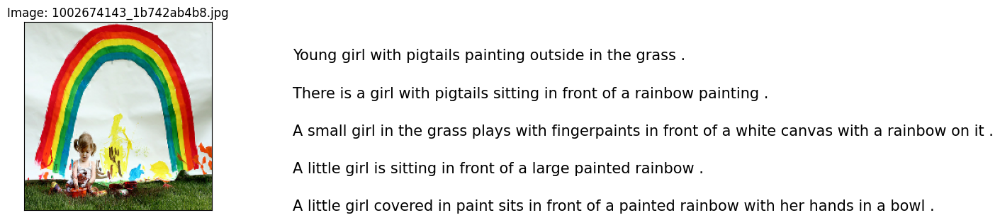

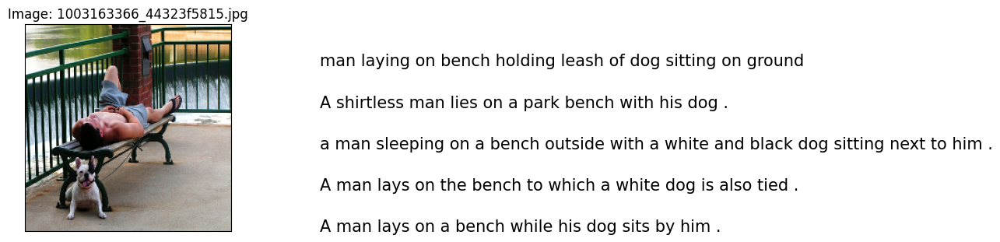

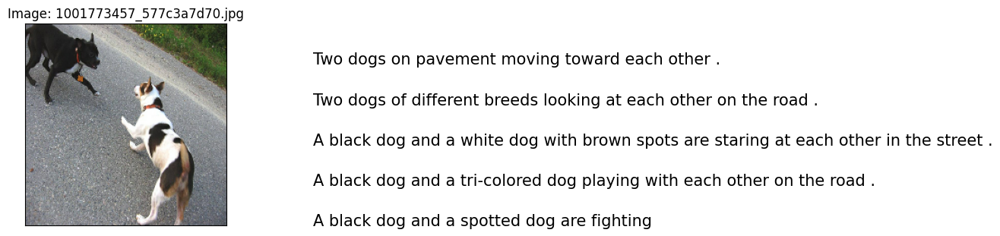

In [ ]:
# Visualize some the images along with their captions

img_path=list(set(df.Path[:20]))   # each image has 5 captions. 20/5 = 4 images
count = 1
j=0
for path in img_path:
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = tf.image.resize(img, [224, 224])

    fig = plt.figure(figsize=(10,20))
    ax = fig.add_subplot(5,2,count,xticks=[],yticks=[])
    ax.imshow(img)
    ax.set_title(f"Image: {os.path.basename(path)}")

    count += 1

    ax = fig.add_subplot(5,2,count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0,1)
    ax.set_ylim(0,5)

    img_cap=df.loc[df['Path'] == path, 'Captions']

    for i in range(len(img_cap)):
        ax.text(0,i,img_cap.iloc[i],fontsize=15)
    count += 1
    j+=1
plt.show()

In [ ]:
if 'df' in locals():
    #Create a list which contains all the captions
    annotations= df['Captions'].tolist()#write your code here

    #add the <start> & <end> token to all those captions as well
    annotations = ["<start> " + caption + " <end>" for caption in annotations]


    #Create a list which contains all the path to the images
    all_img_path=df['Path'].tolist() #write your code here

    print("Total captions present in the dataset: "+ str(len(annotations)))
    print("Total images present in the dataset: " + str(len(all_img_path)))

else:
    print("Cannot create caption lists - no dataframe available")

Total captions present in the dataset: 40455
Total images present in the dataset: 40455



**Inference**
1. The total number of captions and images is 40455 is because of how the data is structured in the dataframe and lists created from it.
2. Each row in the dataframe represents a single image-caption pair.
3. Since there are 8091 images in the dataset and each image has 5 different captions,the total number of these pairs is 8091 * 5 = 40455

<font color = red> **Create vocabulary**

In [ ]:
#Create the vocabulary & the counter for the captions

# vocabulary= #write your code here

# val_count=Counter(vocabulary)
# val_count

if 'df' in locals():
    vocabulary = []
    for sentence in df['Captions']:
        for word in sentence.lower().split():
            vocabulary.append(word)

    vocabulary_count = Counter(vocabulary)
    print(f"Vocabulary created with {len(vocabulary_count)} unique words")
    print(f"Total words in corpus: {len(vocabulary)}")

    # Show 10 common words
    print("\n Top 10 common words:")
    for word, count in vocabulary_count.most_common(10):
        print(f"   {word}: {count}")
else:
    print("Cannot create vocabulary - no dataframe available")

Vocabulary created with 9180 unique words
Total words in corpus: 476665

 Top 10 common words:
   a: 61752
   .: 34212
   in: 18965
   the: 18249
   on: 10732
   is: 9345
   and: 8851
   dog: 8126
   with: 7761
   man: 7238


<font color = red> **Visualise top words**

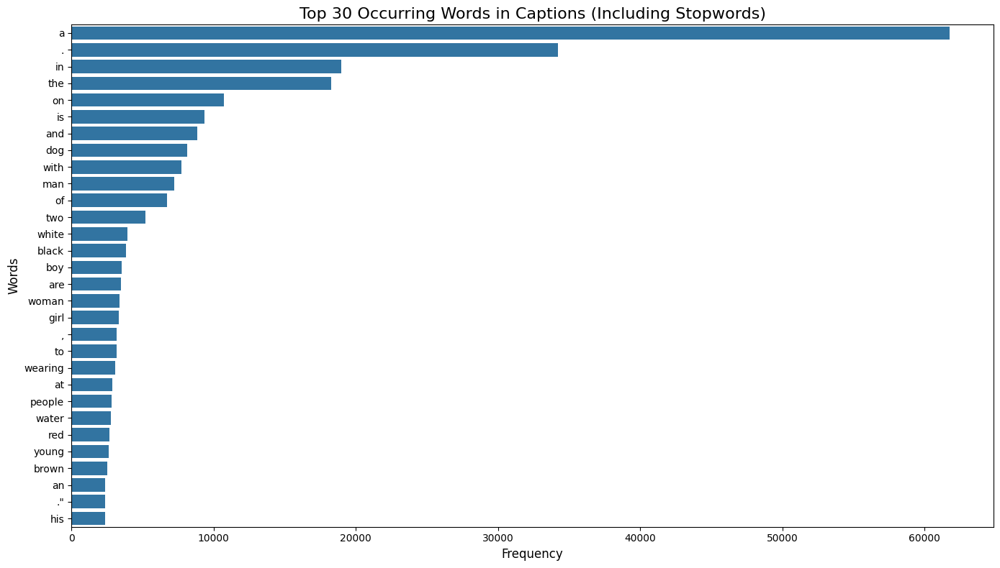

Displayed top 30 terms (including stopwords)


In [ ]:
#Visualise the top 30 occuring words including stop words the captions
#write your code here
if 'vocabulary_count' in locals():
    sort_list = vocabulary_count.most_common(30)
    x, y = [], []

    for word, count in sort_list:
        # if word.lower() not in stop: # Removed stop word filtering
        x.append(word)
        y.append(count)

    plt.figure(figsize=(14, 8))
    sns.barplot(x=y[:30], y=x[:30])  # Show top 30
    plt.title('Top 30 Occurring Words in Captions (Including Stopwords)', fontsize=16)
    plt.xlabel('Frequency', fontsize=12)
    plt.ylabel('Words', fontsize=12)
    plt.tight_layout()
    plt.show()

    print(f"Displayed top {len(x[:30])} terms (including stopwords)")
else:
    print("Cannot visualize words as vocabulary is not available")

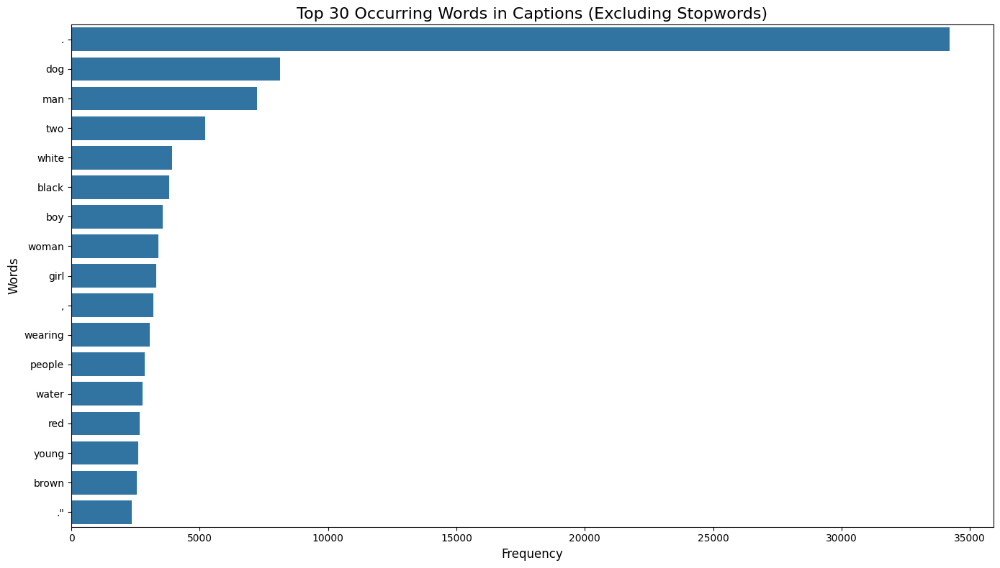

Displayed top 17 non-stopword terms


In [ ]:
#Visualise the top 30 occuring words in the captions excluding stopwords
#write your code here
if 'vocabulary_count' in locals():
    sort_list = vocabulary_count.most_common(30)
    stop = set(stopwords.words('english'))
    x, y = [], []

    for word, count in sort_list:
        if word.lower() not in stop:
            x.append(word)
            y.append(count)

    plt.figure(figsize=(14, 8))
    sns.barplot(x=y[:30], y=x[:30])  # Show top 30
    plt.title('Top 30 Occurring Words in Captions (Excluding Stopwords)', fontsize=16)
    plt.xlabel('Frequency', fontsize=12)
    plt.ylabel('Words', fontsize=12)
    plt.tight_layout()
    plt.show()

    print(f"Displayed top {len(x[:30])} non-stopword terms")
else:
    print("Cannot visualize words as vocabulary is not available")

### <font color = red> **Pre-Processing the captions**
1.Create the tokenized vectors by tokenizing the captions fore ex :split them using spaces & other filters.
This gives us a vocabulary of all of the unique words in the data. Keep the total vocaublary to top 5,000 words for saving memory.

2.Replace all other words with the unknown token "UNK" .

3.Create word-to-index and index-to-word mappings.

4.Pad all sequences to be the same length as the longest one.

In [ ]:
# create the tokenizer
#your code here
if 'annotations' in locals():
    top_k = 5000
    tokenizer = tf.keras.preprocessing.text.Tokenizer(
        num_words=top_k,
        oov_token="<unk>",
        filters=r'!"#$%&()*+.-/:;=?@[\]^_`{|}~ '
    )
    tokenizer.fit_on_texts(annotations)

    print(f"Tokenizer created successfully")
    print(f"Vocabulary size: {len(tokenizer.word_index)}")
    print(f"Target vocabulary size: {top_k}")
else:
    print("Cannot create tokenizer as annotations are not available")

Tokenizer created successfully
Vocabulary size: 8497
Target vocabulary size: 5000


In [ ]:
# Create word-to-index and index-to-word mappings.
if 'tokenizer' in locals():
    #your code here
    word_index = tokenizer.word_index
    index_word = tokenizer.index_word

    train_seqs = tokenizer.texts_to_sequences(annotations)

    tokenizer.word_index['<pad>'] = 0
    tokenizer.index_word[0] = '<pad>'

    print(f"Word mappings created")
    print(f" Original form: {annotations[1]}")
    print(f" Tokenized form: {train_seqs[1]}")

    # Show some word mappings
    print(f"\n Sample word mappings:")
    sample_words = ['<start>', '<end>', '<unk>', '<pad>', 'dog', 'cat', 'man', 'woman']
    for word in sample_words:
        if word in word_index:
            idx = word_index[word]
            print(f"   '{word}' → {idx}")
else:
    print("Cannot create mappings as tokenizer is not available")

Word mappings created
 Original form: <start> A girl going into a wooden building . <end>
 Tokenized form: [3, 2, 20, 318, 66, 2, 198, 119, 4]

 Sample word mappings:
   '<start>' → 3
   '<end>' → 4
   '<unk>' → 1
   '<pad>' → 0
   'dog' → 10
   'cat' → 592
   'man' → 12
   'woman' → 19


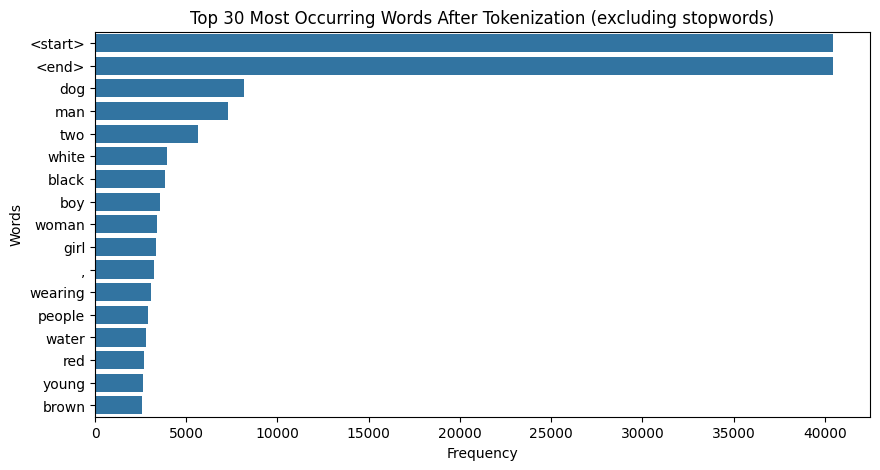

In [ ]:
# Create a word count of your tokenizer to visulize the Top 30 occuring words after text processing

word_counts_tokenizer = tokenizer.word_counts

# Sort the word counts and get the top 30
sorted_word_counts = sorted(word_counts_tokenizer.items(), key=lambda item: item[1], reverse=True)
top_30_words_tokenizer = sorted_word_counts[:30]

# Separate words and counts
words_tokenizer = [word for word, count in top_30_words_tokenizer]
counts_tokenizer = [count for word, count in top_30_words_tokenizer]

# Filter out stop words
stop_words = set(stopwords.words('english'))
filtered_words = []
filtered_counts = []
for word, count in top_30_words_tokenizer:
    if word not in stop_words:
        filtered_words.append(word)
        filtered_counts.append(count)


plt.figure(figsize=(10, 5))
sns.barplot(x=filtered_counts, y=filtered_words)
plt.xticks(rotation=0)
plt.title('Top 30 Most Occurring Words After Tokenization (excluding stopwords)')
plt.xlabel('Frequency')
plt.ylabel('Words')
plt.show()

In [ ]:
# Pad each vector to the max_length of the captions ^ store it to a vairable
# cap_vector= #your code here
# print("The shape of Caption vector is :" + str(cap_vector.shape))
if 'train_seqs' in locals():
    # Find the maximum length of a caption
    max_length = max([len(x) for x in train_seqs])
    print("Maxium length of a caption:\n", max_length)

    # pad captions in the train seqs to reach max length with 0's
    cap_vector = keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post', maxlen=max_length)

    print("The shape of Caption vector is :" + str(cap_vector.shape))
    print("Sample Padded sequences:\n", cap_vector[1])
    print(f"\n Padding statistics:")
    print(f"1. Original sequence lengths: min={min([len(x) for x in train_seqs])}, max={max([len(x) for x in train_seqs])}")
    print(f"2. After padding: all sequences have length {max_length}")
    print(f"3. Total sequences: {len(cap_vector)}")
else:
    print("Cannot pad sequences as tokenized sequences are not available")

Maxium length of a caption:
 40
The shape of Caption vector is :(40455, 40)
Sample Padded sequences:
 [  3   2  20 318  66   2 198 119   4   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0]

 Padding statistics:
1. Original sequence lengths: min=3, max=40
2. After padding: all sequences have length 40
3. Total sequences: 40455


### <font color = red> **Pre-processing the images**

1.Resize them into the shape of (299, 299)

2.Normalize the image within the range of -1 to 1, such that it is in correct format for InceptionV3.

**Resize the images**
* Since you have a list which contains all the image path, you need to first convert them to a dataset using <i>tf.data.Dataset.from_tensor_slices</i>. Once you have created a dataset consisting of image paths, you need to apply a function to the dataset which will apply the necessary preprocessing to each image.
* This function should resize them and also should do the necessary preprocessing that it is in correct format for InceptionV3.


In [ ]:
#write your code here to create the dataset consisting of image paths
image_path_dataset = tf.data.Dataset.from_tensor_slices(all_img_path)

In [ ]:
#write your code here for creating the function. This function should return images & their path

#Preprocess images
def load_image(image_path):
    """
    Load and preprocess image for InceptionV3.
    Args: image_path (str): Path to the image file
    Returns: tuple: Preprocessed image and image path
    """
    # Read and decode image
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)

    # Resize to InceptionV3 input size (299, 299)
    img = tf.image.resize(img, (299, 299))

    # Preprocess for InceptionV3 (normalize to [-1, 1] range)
    img = preprocess_input(img)

    return img, image_path

print("Function processes images to (299, 299) and normalizes for InceptionV3")

Function processes images to (299, 299) and normalizes for InceptionV3


In [ ]:
#write your code here for applying the function to the image path dataset, such that the transformed dataset should contain images & their path

if 'image_path_dataset' in locals():
    print("Applying preprocessing to image dataset...")

    image_dataset = image_path_dataset.map(
        load_image,
        num_parallel_calls=tf.data.experimental.AUTOTUNE
    )

    print(f"Image preprocessing applied successfully")
    print(f"Processed image dataset: {image_dataset}")

    # Test the preprocessing on a sample
    try:
        sample_img, sample_path = next(iter(image_dataset))
        print(f"1. Image shape: {sample_img.shape}")
        print(f"2. Image range: [{sample_img.numpy().min():.2f}, {sample_img.numpy().max():.2f}]")
        print(f"3. Sample path: {sample_path.numpy().decode('utf-8')[-30:]}...")  # Show last 30 chars
    except Exception as e:
        print(f"Error testing preprocessing: {e}")
else:
    print("image_path_dataset is not available")

Applying preprocessing to image dataset...
Image preprocessing applied successfully
Processed image dataset: <_ParallelMapDataset element_spec=(TensorSpec(shape=(299, 299, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.string, name=None))>
1. Image shape: (299, 299, 3)
2. Image range: [-1.00, 1.00]
3. Sample path: ages/1000268201_693b08cb0e.jpg...


In [ ]:
image_dataset

<_ParallelMapDataset element_spec=(TensorSpec(shape=(299, 299, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.string, name=None))>

## <font color = red> **Modelling Building**


**Architecture**


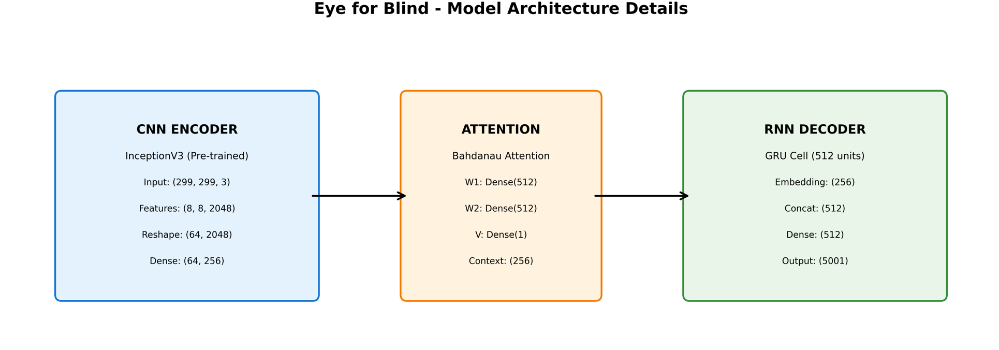

### <font color = red> **Load the pretrained Imagenet weights of Inception net V3**

1.To save the memory(RAM) from getting exhausted, extract the features of the images using the last layer of pre-trained model. Including this as part of training will lead to higher computational time.

2.The shape of the output of this layer is 8x8x2048.

3.Use a function to extract the features of each image in the train & test dataset such that the shape of each image should be (batch_size, 8*8, 2048)



In [ ]:
# initialize model and load pretrained weights
image_model = tf.keras.applications.InceptionV3(include_top=False,weights='imagenet')
new_input = image_model.input
hidden_layer = image_model.layers[-1].output

#model
base_model = keras.Model(new_input, hidden_layer)
print(f"InceptionV3 loaded")
base_model.summary()

InceptionV3 loaded


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_94 (Conv2D)  │ (None, None,      │        864 │ input_layer_1[0]… │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │         96 │ conv2d_94[0][0]   │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_94       │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_95 (Conv2D)  │ (None, None,      │      9,216 │ activation_94[0]… │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │         96 │ conv2d_95[0][0]   │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_95       │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_96 (Conv2D)  │ (None, None,      │     18,432 │ activation_95[0]… │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        192 │ conv2d_96[0][0]   │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_96       │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, None,      │          0 │ activation_96[0]… │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_97 (Conv2D)  │ (None, None,      │      5,120 │ max_pooling2d_4[… │
│                     │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        240 │ conv2d_97[0][0]   │
│ (BatchNormalizatio… │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_97       │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_98 (Conv2D)  │ (None, None,      │    138,240 │ activation_97[0]… │
│                     │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        576 │ conv2d_98[0][0]   │
│ (BatchNormalizatio… │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_98       │ (None, None,      │          0 │ batch_normalizat

 Total params: 21,802,784 (83.17 MB)

 Trainable params: 21,768,352 (83.04 MB)

 Non-trainable params: 34,432 (134.50 KB)

lengthy execution - save npy once and use multiple time

In [ ]:
# write the code to apply the feature_extraction model to your earlier created dataset which contained images & their respective paths
# Once the features are created, you need to reshape them such that feature shape is in order of (batch_size, 8*8, 2048)

#TODO: revisit - handles unique images, batching, and checks for existing features.
# Create a dictionary to store image features
image_features = {}
feature_file = '/content/drive/MyDrive/Capstone_EyeForBlind/flickr8k_data/image_features.npy'

# Check if features already exist
import os
if os.path.exists(feature_file):
    image_features = np.load(feature_file, allow_pickle=True).item() #cached
    print("Loaded existing image features.")
else:
    # Iterate over the image dataset and extract features
    for img, path in tqdm(image_dataset):
        # Add a batch dimension to the image tensor
        img = tf.expand_dims(img, axis=0)
        # Extract features using the base model
        batch_features = base_model(img)
        # Reshape the features
        batch_features = tf.reshape(batch_features,(batch_features.shape[0], -1, batch_features.shape[3]))
        # Store the features in the dictionary with the image path as the key
        image_features[path.numpy().decode('utf-8')] = batch_features.numpy()

    # Save the extracted features
    np.save(feature_file, image_features)
    print("Image feature extraction complete and saved.")

Loaded existing image features.


### FAQs on how to store the features:
* You can store the features using a dictionary with the path as the key and values as the feature extracted by the inception net v3 model OR
* You can store using numpy(np.save) to store the resulting vector.

### <font color = red> **Dataset creation**
1.Apply train_test_split on both image path & captions to create the train & test list. Create the train-test spliit using 80-20 ratio & random state = 42

2.Create a function which maps the image path to their feature.

3.Create a builder function to create train & test dataset & apply the function created earlier to transform the dataset

2.Make sure you have done Shuffle and batch while building the dataset

3.The shape of each image in the dataset after building should be (batch_size, 8*8, 2048)

4.The shape of each caption in the dataset after building should be(batch_size, max_len)


In [ ]:
#write your code here

# Shuffle captions and image_names together
all_img_path, cap_vector = shuffle(all_img_path, cap_vector, random_state=42)

# Create training and validation sets using an 80-20 split
path_train, path_test, cap_train, cap_test = train_test_split(all_img_path, cap_vector, random_state=42)

# path_train, path_test, cap_train, cap_test = train_test_split( #your code goes here)

In [ ]:
print("Training data for images: " + str(len(path_train)))
print("Testing data for images: " + str(len(path_test)))
print("Training data for Captions: " + str(len(cap_train)))
print("Testing data for Captions: " + str(len(cap_test)))

Training data for images: 30341
Testing data for images: 10114
Training data for Captions: 30341
Testing data for Captions: 10114


In [ ]:
# Create a function which maps the image path to their feature.
# This function will take the image_path & caption and return it's feature & respective caption.

# Set Batch and Buffer Size
BATCH_SIZE = 64
BUFFER_SIZE = 2000

# To load image features

def map_func(img_name, cap):
    # Decode the image name (path) from bytes to string
    # img_path_str = img_name.decode('utf-8') # Removed decoding
    # Handle both tensor and numpy array input for robustness
    if isinstance(img_name, tf.Tensor):
        img_path_str = img_name.numpy().decode('utf-8')
    elif isinstance(img_name, np.ndarray):
        img_path_str = img_name.decode('utf-8')
    else:
        # Assume it's already a string if not a tensor or numpy array
        img_path_str = img_name

    # Look up the feature tensor in the loaded dictionary
    img_tensor = image_features[img_path_str].squeeze() # Remove the extra dimension here
    return img_tensor, cap

def tf_map_func(img_name, cap):
    # Ensure img_name is a TensorFlow string tensor before passing to py_function
    img_name_tf = tf.convert_to_tensor(img_name, dtype=tf.string)
    # Pass img_name as bytes to map_func
    img_tensor, cap = tf.py_function(map_func, [img_name_tf, cap], [tf.float32, tf.int32])
    img_tensor.set_shape([64, 2048])
    cap.set_shape([max_length])
    return img_tensor, cap
# def map_func(# your input variable goes here):
#   img_tensor = # write your code here to extract the features from the dictionary stored earlier
#   return

### <font color = red> **Load the features:**
* You can load the features using the dictionary created earlier OR
* You can store using numpy(np.load) to load the feature vector.

In [ ]:
# create a builder function to create dataset which takes in the image path & captions as input
# This function should transform the created dataset(img_path,cap) to (features,cap) using the map_func created earlier

def gen_dataset(img_data, cap_data):
    dataset = tf.data.Dataset.from_tensor_slices((img_data, cap_data))
    dataset = dataset.shuffle(BUFFER_SIZE)

    # Use the proper tf_map_func (with shape setting)
    dataset = dataset.map(tf_map_func, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

    return dataset

In [ ]:
train_dataset=gen_dataset(path_train,cap_train)
test_dataset=gen_dataset(path_test,cap_test)

In [ ]:
sample_img_batch, sample_cap_batch = next(iter(train_dataset))
print(sample_img_batch.shape)  #(batch_size, 8*8, 2048)
print(sample_cap_batch.shape) #(batch_size,max_len)

(64, 64, 2048)
(64, 40)


### <font color = red> **Model Building**
1.Set the parameters

2.Build the Encoder, Attention model & Decoder

In [ ]:
#Set the parameters - Hyperparameters

embedding_dim = 256
units = 512
vocab_size = top_k + 1 #top 5,000 words +1
train_num_steps = len(path_train) // BATCH_SIZE
test_num_steps = len(path_test) // BATCH_SIZE

###  <font color = red>  **Encoder**

In [ ]:
class CNN_Custom_Encoder(keras.Model):
    # to pass extracted features through FC layer
    def __init__(self, embedding_dim):
        super(CNN_Custom_Encoder, self).__init__()
        self.fc = layers.Dense(embedding_dim)
        #self.dropout = layers.Dropout(0.5)

    def call(self, x):
        x = self.fc(x)
        x = tf.nn.relu(x)
        return x

###  <font color = red>  **Attention model**

In [ ]:
# Attention mechanism
class BahdanauAttention(tf.keras.Model):
    def __init__(self, units):
        super(BahdanauAttention, self).__init__()
        self.W1 = tf.keras.layers.Dense(units) # This layer will be applied to the image features.
        self.W2 = tf.keras.layers.Dense(units) # This layer will be applied to the hidden state of the decoder.
        self.V = tf.keras.layers.Dense(1) # This layer will be used to calculate the attention scores.

    def call(self, features, hidden):
        hidden_with_time_axis = tf.expand_dims(hidden, 1)  # To expand the hidden shape to shape: (batch_size, 1, hidden_size)
        attention_hidden_layer = tf.nn.tanh(self.W1(features) + self.W2(hidden_with_time_axis))
        score = self.V(attention_hidden_layer) # build score funciton to shape: (batch_size, 8*8, units)
        attention_weights = tf.nn.softmax(score, axis=1) # to extract attention weights with shape: (batch_size, 8*8, 1)
        context_vector = attention_weights * features  #create the context vector with shape (batch_size, 8*8,embedding_dim)
        context_vector = tf.reduce_sum(context_vector, axis=1) # reduce the shape to (batch_size, embedding_dim)
        return context_vector, attention_weights

print("BahdanauAttention mechanism defined")

BahdanauAttention mechanism defined


In [ ]:
class DotProductAttention(tf.keras.Model):
    """Dot-product attention for fast inference"""
    def __init__(self, units):
        super(DotProductAttention, self).__init__()
        self.units = units
        # No dense layers needed - just scaling!
        self.scale = tf.math.sqrt(tf.cast(units, tf.float32))

    def call(self, features, hidden):
        # features: (batch_size, 64, embedding_dim)
        # hidden: (batch_size, hidden_size)

        # Simple dot product
        scores = tf.matmul(features, tf.expand_dims(hidden, -1))  # (batch_size, 64, 1)
        scores = scores / self.scale  # Scale for stability

        attention_weights = tf.nn.softmax(scores, axis=1)
        context_vector = tf.reduce_sum(attention_weights * features, axis=1)

        return context_vector, attention_weights

print("Dot-product mechanism defined")

Dot-product mechanism defined


In [ ]:
class LuongAttention(tf.keras.Model):
    """
    Luong (Multiplicative) Attention Mechanism
    - Faster than Bahdanau (fewer parameters)
    - Better than Dot-Product (more expressive)
    - Good balance of speed and performance
    """
    def __init__(self, units):
        super(LuongAttention, self).__init__()
        self.units = units
        # Single transformation matrix (fewer parameters than Bahdanau)
        self.W = tf.keras.layers.Dense(units, use_bias=False)

    def call(self, features, hidden):
        # features: (batch_size, 64, embedding_dim)
        # hidden: (batch_size, hidden_size)

        # Transform hidden state to match feature dimension
        # hidden_transformed: (batch_size, embedding_dim)
        hidden_transformed = self.W(hidden)

        # Expand for broadcasting: (batch_size, 1, embedding_dim)
        hidden_expanded = tf.expand_dims(hidden_transformed, 1)

        # Compute attention scores using element-wise multiplication
        # scores: (batch_size, 64, embedding_dim)
        scores = features * hidden_expanded

        # Sum across embedding dimension to get final scores
        # attention_scores: (batch_size, 64, 1)
        attention_scores = tf.reduce_sum(scores, axis=2, keepdims=True)

        # Apply softmax to get attention weights
        attention_weights = tf.nn.softmax(attention_scores, axis=1)

        # Compute context vector
        # context_vector: (batch_size, embedding_dim)
        context_vector = tf.reduce_sum(attention_weights * features, axis=1)

        return context_vector, attention_weights

print("Luong Attention mechanism defined")

Luong Attention mechanism defined


Attention types
- Bahdanau (Additive - tanh(W1 * h + W2 * s) - More parameters, can model complex relationships

- Luong (Multiplicative - h^T * W * s) - Fewer parameters, computationally efficient

- Dot-Produc(th^T * s) - Simplest, fastest, but limited expressiveness

With limited compute:

- Start with Dot-Product - get it working fast and check results
- If results aren't good enough - upgrade to Luong
- Only use Bahdanau - if time and compute power exists

In [ ]:
attention_type = 'bahdanau'

###  <font color = red> **Decoder**

Tried various attention types for distinguished results

In [ ]:
# Change and pass different attention_type to this decoder to try different attention types

# class RNN_Custom_Decoder(keras.Model):
#     def __init__(self, embed_dim, units, vocab_size, attention_type='bahdanau'):
#         super().__init__()
#         self.units=units
#         #iniitalise Attention model with units

#         # Choose attention based on type
#         if attention_type == 'luong':
#             self.attention = LuongAttention(self.units)
#         elif attention_type == 'dot_product':
#             self.attention = DotProductAttention(self.units)
#         else:
#             self.attention = BahdanauAttention(self.units)
#         #build Embedding layer
#         self.embed = layers.Embedding(vocab_size, embed_dim,mask_zero=True)
#         # self.units: The number of units in the GRU.
#         # return_sequences=True: GRU will return the output for each time step in the sequence.
#         # return_state=True: GRU will return the final hidden state after processing the sequence.
#         # recurrent_initializer='glorot_uniform': Sets the initializer for the recurrent kernel weights.
#         self.gru = layers.GRU(self.units,return_sequences=True,return_state=True,recurrent_initializer='glorot_uniform')
#         self.fc1 = layers.Dense(self.units)
#         self.fc2 = layers.Dense(vocab_size)
#         #self.dropout = Dropout(0.5)

#     def call(self, x, features, hidden, training=False):
#         context_vector, attention_weights = self.attention(features, hidden)
#         x = self.embed(x)
#         x = tf.concat([tf.expand_dims(context_vector, 1), x], axis = -1)

#         # The GRU layer returns a tuple when return_sequences=True and return_state=True
#         # The tuple contains (output, state)
#         # gru_outputs = self.gru(x, initial_state=hidden, training = training) # Pass hidden state explicitly

#         # if isinstance(gru_outputs, (list, tuple)) and len(gru_outputs) >= 2:
#         #     gru_output, state = gru_outputs[0], gru_outputs[1]
#         # else:
#         #     gru_output = gru_outputs if not isinstance(gru_outputs, (list, tuple)) else gru_outputs[0]
#         #     state = hidden
#         gru_outputs = self.gru(x, initial_state=hidden, training=training)
#         gru_output = gru_outputs[0]  # (batch, seq, units)
#         raw_state = gru_outputs[1]
#         batch_size = tf.shape(gru_output)[0]
#         if len(raw_state.shape) == 1:
#             # Expand and tile to match batch size
#             state = tf.expand_dims(raw_state, 0)  # (1, units)
#             state = tf.tile(state, [batch_size, 1])  # (batch, units)
#         else:
#             state = raw_state

#         x = self.fc1(gru_output)
#         x = tf.reshape(x, (-1, x.shape[2]))
#         x = self.fc2(x)          # logits
#         return x, state , attention_weights

#     # initialize the hidden state of the GRU with zeros at the beginning of the caption generation process
#     # for a batch of a given size.
#     def init_state(self, batch_size):
#         return tf.zeros((batch_size, self.units))

GRU with mask enabled(mask_zero=True)

In [ ]:
# GRU with mask enabled(mask_zero=True)

# class RNN_Custom_Decoder(keras.Model):
#     def __init__(self, embed_dim, units, vocab_size):
#         super().__init__()
#         self.units = units
#         self.attention = BahdanauAttention(self.units)
#         self.embed = layers.Embedding(vocab_size, embed_dim, mask_zero=True)
#         self.gru = layers.GRU(self.units, return_sequences=True, return_state=True, recurrent_initializer='glorot_uniform')
#         self.fc1 = layers.Dense(self.units)
#         self.fc2 = layers.Dense(vocab_size)

#     def call(self, x, features, hidden, training=False):
#         context_vector, attention_weights = self.attention(features, hidden)
#         x = self.embed(x)
#         x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

#         gru_outputs = self.gru(x, initial_state=hidden, training=training)

#         gru_output = gru_outputs[0]  # Sequences
#         raw_state = gru_outputs[1]   # State

#         batch_size = tf.shape(gru_output)[0]
#         state = tf.tile(tf.expand_dims(raw_state, 0), [batch_size, 1])

#         x = self.fc1(gru_output)
#         x = tf.reshape(x, (-1, x.shape[2]))
#         x = self.fc2(x)

#         return x, state, attention_weights

#     def init_state(self, batch_size):
#         return tf.zeros((batch_size, self.units))

GRU with mask disabled(mask_zero=False)

In [ ]:
# class RNN_Custom_Decoder(keras.Model):
#     def __init__(self, embed_dim, units, vocab_size):
#         super().__init__()
#         self.units = units
#         self.attention = BahdanauAttention(self.units)
#         self.embed = layers.Embedding(vocab_size, embed_dim, mask_zero=False)
#         self.gru_cell = layers.GRUCell(self.units, recurrent_initializer='glorot_uniform')
#         self.fc1 = layers.Dense(self.units)
#         self.fc2 = layers.Dense(vocab_size)

#     def call(self, x, features, hidden, training=False):
#         context_vector, attention_weights = self.attention(features, hidden)
#         x = self.embed(x)
#         x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

#         batch_size = tf.shape(x)[0]
#         seq_length = tf.shape(x)[1]  # Usually 1 for caption generation

#         # Collect outputs for each timestep
#         outputs = []
#         state = hidden

#         for t in range(seq_length):
#             timestep_input = x[:, t, :]  # (batch_size, features)
#             output, state = self.gru_cell(timestep_input, state, training=training)
#             outputs.append(output)

#         # Stack to get (batch_size, max_length, hidden_size)
#         gru_output = tf.stack(outputs, axis=1)  # ✅ Required shape

#         x = self.fc1(gru_output)
#         x = tf.reshape(x, (-1, x.shape[2]))
#         x = self.fc2(x)

#         return x, state, attention_weights


#     def init_state(self, batch_size):
#         return tf.zeros((batch_size, self.units))

GRUCell with mask disabled

Model is running into problems(shape mismatches, symbolic graph errors, or gradient flow issues) so switching to GRUCell inside a tf.keras.layers.RNN wrapper as a stable fallback mechanism.

In [ ]:
# GRUCell with mask zero
class RNN_Custom_Decoder(keras.Model):
    def __init__(self, embed_dim, units, vocab_size):
        super().__init__()
        self.units = units
        self.attention = BahdanauAttention(self.units)
        self.embed = layers.Embedding(vocab_size, embed_dim, mask_zero=False)

        self.gru_cell = layers.GRUCell(self.units, recurrent_initializer='glorot_uniform')

        self.fc1 = layers.Dense(self.units)
        self.fc2 = layers.Dense(vocab_size)

    def call(self, x, features, hidden, training=False):
        context_vector, attention_weights = self.attention(features, hidden)
        x = self.embed(x)
        x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

        # Manual GRU processing - for graph compatibility
        # x shape: (batch, 1, input_dim) - we process the single timestep
        gru_input = x[:, 0, :]  # Take the single timestep: (batch, input_dim)

        # Process through GRU cell
        gru_output, new_hidden = self.gru_cell(gru_input, hidden, training=training)

        # Reshape output to match expected format
        gru_output = tf.expand_dims(gru_output, 1)  # (batch, 1, units)

        x = self.fc1(gru_output)
        x = tf.reshape(x, (-1, x.shape[2]))
        x = self.fc2(x)

        return x, new_hidden, attention_weights

    def init_state(self, batch_size):
        return tf.zeros((batch_size, self.units))

### <font color = red> **Model training & optimization**
1.Set the optimizer & loss object

2.Create your checkpoint path

3.Create your training & testing step functions

4.Create your loss function for the test dataset


**Flow Diagram**

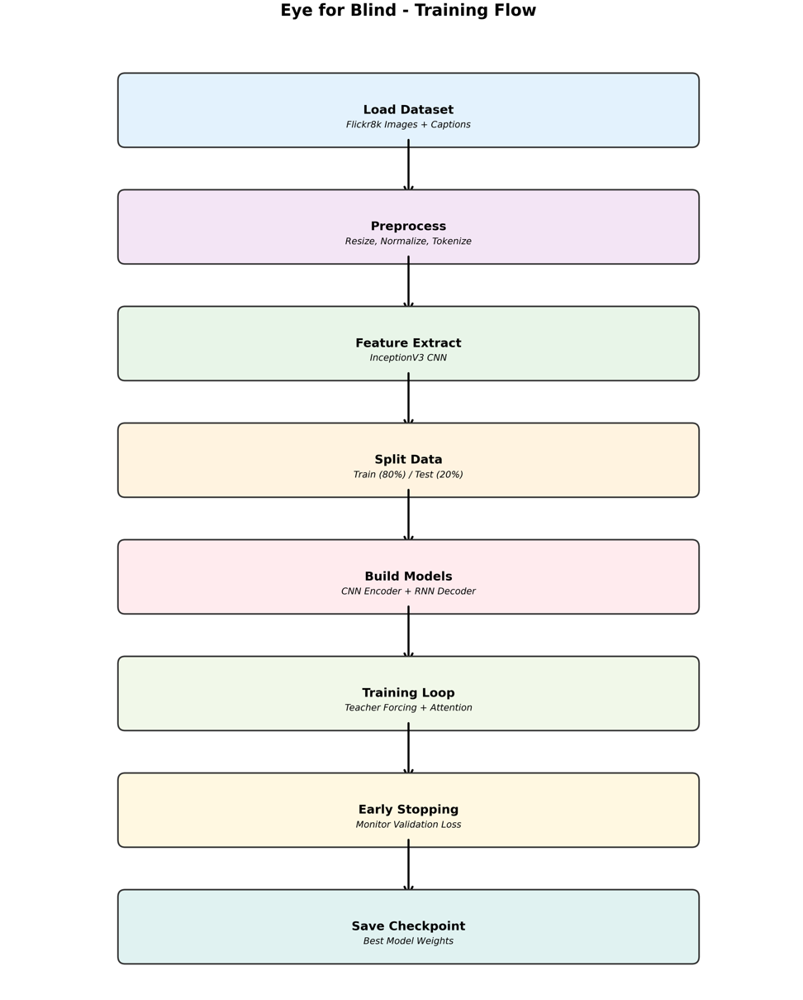

In [ ]:
# optimizer = #define the optimizer
# loss_object = #define your loss object
try:
    encoder=CNN_Custom_Encoder(embedding_dim)
    decoder=RNN_Custom_Decoder(embedding_dim, units, vocab_size)
    # Set Optmizer and Loss Object
    optimizer = tf.keras.optimizers.Adam()
    loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

    def loss_function(real, pred):
        mask = tf.math.logical_not(tf.math.equal(real, 0))
        loss_ = loss_object(real, pred)
        mask = tf.cast(mask, dtype=loss_.dtype)
        loss_ *= mask
        return tf.reduce_mean(loss_)

    print("Models Architecture: CNN Encoder + RNN Decoder + Attention initialized successfully")
except Exception as e:
    print(f"Model initialization failed: {e}")

Models Architecture: CNN Encoder + RNN Decoder + Attention initialized successfully


In [ ]:
verify_model_shapes = True

if verify_model_shapes:
    features=encoder(sample_img_batch)

    hidden = decoder.init_state(batch_size=sample_cap_batch.shape[0])
    dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * sample_cap_batch.shape[0], 1)

    predictions,hidden_out, attention_weights= decoder(dec_input, features, hidden)
    # predictions, hidden_out, attention_weights = decoder(dec_input, features, hidden, training=False)
    print('Feature shape from Encoder: {}'.format(features.shape)) #(batch, 8*8, embed_dim)
    print('Predcitions shape from Decoder: {}'.format(predictions.shape)) #(batch,vocab_size)
    print('Attention weights shape from Decoder: {}'.format(attention_weights.shape)) #(batch, 8*8, embed_dim)

Feature shape from Encoder: (64, 64, 256)
Predcitions shape from Decoder: (64, 5001)
Attention weights shape from Decoder: (64, 64, 1)


In [ ]:
checkpoint_path = "/content/drive/MyDrive/Capstone_EyeForBlind/checkpoints/train"
os.makedirs(checkpoint_path, exist_ok=True)   # ensure folder exists
ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer = optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

In [ ]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
    try:
        ckpt.restore(ckpt_manager.latest_checkpoint).expect_partial()
        start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])
        print(f"Restored checkpoint from epoch {start_epoch}")
        print(f"Checkpoint path: {ckpt_manager.latest_checkpoint}")
    except Exception as e:
        print(f"Failed to restore checkpoint: {e}")
        print("Starting training from scratch")
        start_epoch = 0
else:
    print("No existing checkpoint found - starting fresh training")


# the model weights + optimizer states are restored, and
# loop starts from the correct epoch number.

Restored checkpoint from epoch 1
Checkpoint path: /content/drive/MyDrive/Capstone_EyeForBlind/checkpoints/train/ckpt-1


* While creating the training step for your model, you will apply Teacher forcing.
* Teacher forcing is a technique where the target/real word is passed as the next input to the decoder instead of previous prediciton.

In [ ]:
# train function - teacher forcing
@tf.function
def train_step(img_tensor, target):
    loss = 0.0
    batch_size = tf.shape(target)[0]
    hidden = decoder.init_state(batch_size=batch_size)
    dec_input = tf.expand_dims(tf.repeat(tokenizer.word_index['<start>'], batch_size), 1)

    with tf.GradientTape() as tape:
        # write your code here to do the training steps
        features = encoder(img_tensor, training=True)
        seq_len = tf.shape(target)[1]             # <- dynamic length
        for t in tf.range(1, seq_len):            # <- tf.range, not Python range
            logits, hidden, _ = decoder(dec_input, features, hidden, training=True)
            loss += loss_function(target[:, t], logits)
            dec_input = tf.expand_dims(target[:, t], 1)  # teacher forcing

    avg_loss = loss / tf.cast(seq_len, tf.float32)
    vars_ = encoder.trainable_variables + decoder.trainable_variables
    grads = tape.gradient(loss, vars_)
    optimizer.apply_gradients(zip(grads, vars_))
    return loss, avg_loss

* While creating the test step for your model, you will pass your previous prediciton as the next input to the decoder.

In [ ]:
# test function - without teacher forcing
@tf.function
def test_step(img_tensor, target):
    loss = 0.0
    batch_size = tf.shape(target)[0]
    hidden = decoder.init_state(batch_size=batch_size)
    dec_input = tf.expand_dims(tf.repeat(tokenizer.word_index['<start>'], batch_size), 1)

    features = encoder(img_tensor, training=False)

    seq_len = tf.shape(target)[1]
    for t in tf.range(1, seq_len):
        logits, hidden, _ = decoder(dec_input, features, hidden, training=False)
        loss += loss_function(target[:, t], logits)
        # greedy step
        next_id = tf.argmax(logits, axis=1, output_type=tf.int32)
        dec_input = tf.expand_dims(next_id, 1)

    avg_loss = loss / tf.cast(seq_len, tf.float32)
    return loss, avg_loss

In [ ]:
# test loss function
def test_loss_cal(test_dataset):
    total_loss_test = 0

    #write your code to get the average loss result on your test data
    for (batch, (img_tensor, target)) in enumerate(test_dataset):
        batch_loss, t_loss = test_step(img_tensor, target)
        total_loss_test += t_loss
        avg_test_loss=total_loss_test / test_num_steps

    return avg_test_loss

Do not delete

In [ ]:
# Below code is bringing train and test loss values - test loss is increasing with each epoch.
# Results displayed below and techniques to avoid overfitting suggested.

# loss_plot = []
# test_loss_plot = []
# EPOCHS = 15

# best_test_loss = 100

# for epoch in tqdm(range(0, EPOCHS)):
#     start = time.time()
#     total_loss = 0

#     for (batch, (img_tensor, target)) in enumerate(train_dataset):
#         batch_loss, t_loss = train_step(img_tensor, target)
#         total_loss += t_loss

#         if batch % 100 == 0:
#             print(f'Epoch {epoch+1} Batch {batch} Loss {batch_loss:.4f}')

#     avg_train_loss = total_loss / train_num_steps
#     loss_plot.append(avg_train_loss)

#     test_loss = test_loss_cal(test_dataset)
#     test_loss_plot.append(test_loss)

#     print(f'Epoch {epoch+1}: Train Loss {avg_train_loss:.3f}, Test Loss {test_loss:.3f}')
#     print(f'Time: {time.time() - start:.1f}s\n')

#     if test_loss < best_test_loss:
#         print(f'Test loss improved: {best_test_loss:.3f} → {test_loss:.3f}')
#         best_test_loss = test_loss
#         ckpt_manager.save()

Training Data indicates Model is overfitting - as the training loss is decreasing and Test loss is increasing.

Adopt techniques
- Early Stopping
- or Add Regularization
- or Reduce Learning Rate.

Data

Epoch 1 Batch 0 Loss 96.0130
Epoch 1 Batch 100 Loss 52.8240
Epoch 1 Batch 200 Loss 43.1837
Epoch 1 Batch 300 Loss 45.5533
Epoch 1 Batch 400 Loss 40.3649
Epoch 1: Train Loss 1.205, Test Loss 1.878
Time: 144.7s

Test loss improved: 100.000 → 1.878
  7%|▋         | 1/15 [02:25<33:55, 145.42s/it]Epoch 2 Batch 0 Loss 33.6951
Epoch 2 Batch 100 Loss 36.5187
Epoch 2 Batch 200 Loss 36.7140
Epoch 2 Batch 300 Loss 34.7017
Epoch 2 Batch 400 Loss 32.8279
 13%|█▎        | 2/15 [05:07<33:40, 155.40s/it]Epoch 2: Train Loss 0.897, Test Loss 2.018
Time: 162.4s

Epoch 3 Batch 0 Loss 35.2343
Epoch 3 Batch 100 Loss 30.2890
Epoch 3 Batch 200 Loss 28.6466
Epoch 3 Batch 300 Loss 31.9630
Epoch 3 Batch 400 Loss 31.2484
 20%|██        | 3/15 [07:52<31:58, 159.86s/it]Epoch 3: Train Loss 0.795, Test Loss 2.022
Time: 165.2s

Epoch 4 Batch 0 Loss 30.8630
Epoch 4 Batch 100 Loss 27.5708
Epoch 4 Batch 200 Loss 27.3855
Epoch 4 Batch 300 Loss 28.5182
Epoch 4 Batch 400 Loss 24.5755
 27%|██▋       | 4/15 [10:35<29:28, 160.74s/it]Epoch 4: Train Loss 0.721, Test Loss 2.020
Time: 162.1s

Epoch 5 Batch 0 Loss 27.2345
Epoch 5 Batch 100 Loss 29.2730
Epoch 5 Batch 200 Loss 25.6394
Epoch 5 Batch 300 Loss 25.5381
Epoch 5 Batch 400 Loss 26.4792
 33%|███▎      | 5/15 [13:04<26:05, 156.50s/it]Epoch 5: Train Loss 0.656, Test Loss 2.130
Time: 149.0s

Epoch 6 Batch 0 Loss 23.1640
Epoch 6 Batch 100 Loss 22.3494
Epoch 6 Batch 200 Loss 24.7720
Epoch 6 Batch 300 Loss 25.2932
Epoch 6 Batch 400 Loss 22.4764
 40%|████      | 6/15 [15:20<22:26, 149.57s/it]Epoch 6: Train Loss 0.596, Test Loss 2.184
Time: 136.1s

Epoch 7 Batch 0 Loss 21.5670
Epoch 7 Batch 100 Loss 20.5044
Epoch 7 Batch 200 Loss 21.1113
Epoch 7 Batch 300 Loss 20.7439
Epoch 7 Batch 400 Loss 20.5158
 47%|████▋     | 7/15 [18:00<20:23, 152.93s/it]Epoch 7: Train Loss 0.538, Test Loss 2.318
Time: 159.8s

Epoch 8 Batch 0 Loss 21.1012
Epoch 8 Batch 100 Loss 19.6023
Epoch 8 Batch 200 Loss 17.8044
Epoch 8 Batch 300 Loss 17.6488
Epoch 8 Batch 400 Loss 20.3758
 53%|█████▎    | 8/15 [20:42<18:11, 155.94s/it]Epoch 8: Train Loss 0.484, Test Loss 2.473
Time: 162.4s

Epoch 9 Batch 0 Loss 19.1686
Epoch 9 Batch 100 Loss 16.9690
Epoch 9 Batch 200 Loss 16.4149
Epoch 9 Batch 300 Loss 16.4553
Epoch 9 Batch 400 Loss 17.6481
 60%|██████    | 9/15 [22:57<14:56, 149.40s/it]Epoch 9: Train Loss 0.434, Test Loss 2.601
Time: 135.0s

Epoch 10 Batch 0 Loss 19.4657
Epoch 10 Batch 100 Loss 15.1750
Epoch 10 Batch 200 Loss 15.9515
Epoch 10 Batch 300 Loss 15.7340
Epoch 10 Batch 400 Loss 13.8251
 67%|██████▋   | 10/15 [25:27<12:28, 149.62s/it]Epoch 10: Train Loss 0.389, Test Loss 2.759
Time: 150.1s

In [ ]:
# def plot_training_results(train_losses, test_losses):
#     """Plotting train vs test results"""

#     plt.figure(figsize=(15, 5))

#     # Subplot 1: Loss curves (your current plot, enhanced)
#     plt.subplot(1, 3, 1)
#     epochs = range(1, len(train_losses) + 1)
#     plt.plot(epochs, train_losses, 'b-', label='Training Loss', linewidth=2)
#     plt.plot(epochs, test_losses, 'g-', label='Validation Loss', linewidth=2)
#     plt.xlabel('Epochs', fontsize=12)
#     plt.ylabel('Loss', fontsize=12)
#     plt.title('Training & Validation Loss', fontsize=14, fontweight='bold')
#     plt.legend()
#     plt.grid(True, alpha=0.3)

#     # Subplot 2: Overfitting check
#     plt.subplot(1, 3, 2)
#     loss_diff = [abs(t - v) for t, v in zip(train_losses, test_losses)]
#     plt.plot(epochs, loss_diff, 'r-', linewidth=2)
#     plt.xlabel('Epochs', fontsize=12)
#     plt.ylabel('|Train - Val| Loss', fontsize=12)
#     plt.title('Overfitting Monitor', fontsize=14, fontweight='bold')
#     plt.grid(True, alpha=0.3)

#     # Subplot 3: Summary stats
#     plt.subplot(1, 3, 3)
#     plt.axis('off')

#     best_epoch = epochs[test_losses.index(min(test_losses))]
#     summary_text = f"""
#     Training Summary

#     Total Epochs: {len(train_losses)}
#     Best Val Loss: {min(test_losses):.4f}
#     Best Epoch: {best_epoch}
#     Final Train: {train_losses[-1]:.4f}
#     Final Val: {test_losses[-1]:.4f}

#     Status: {'Good' if abs(train_losses[-1] - test_losses[-1]) < 0.2 else 'Check Overfitting'}
#     """

#     plt.text(0.1, 0.5, summary_text, fontsize=11, verticalalignment='center',
#              bbox=dict(boxstyle="round,pad=0.3", facecolor="lightblue", alpha=0.7))

#     plt.tight_layout()
#     plt.show()

In [ ]:
# plot_training_results(loss_plot, test_loss_plot)

In [ ]:
# Training parameters
EPOCHS = 15
loss_plot = []
test_loss_plot = []

In [ ]:
def plot_training_with_early_stopping(loss_plot, test_loss_plot, best_epoch, stopped_early):
    """Plot training results with early stopping indicators"""

    plt.figure(figsize=(12, 8))

    epochs = range(1, len(loss_plot) + 1)

    # Main plot
    plt.subplot(2, 1, 1)
    plt.plot(epochs, loss_plot, 'b-o', label='Training Loss', linewidth=2)
    plt.plot(epochs, test_loss_plot, 'r-o', label='Test Loss', linewidth=2)

    # Mark best epoch
    plt.axvline(x=best_epoch, color='green', linestyle='--', alpha=0.7, label=f'Best Model (Epoch {best_epoch})')

    # Mark early stopping point if applicable
    if stopped_early:
        plt.axvline(x=len(epochs), color='orange', linestyle='--', alpha=0.7, label='Early Stopping')

    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Progress with Early Stopping')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # Summary stats
    plt.subplot(2, 1, 2)
    plt.axis('off')

    summary_text = f"""
    Training Summary:

    Best Epoch: {best_epoch}
    Best Test Loss: {min(test_loss_plot):.4f}
    Final Train Loss: {loss_plot[-1]:.4f}
    Final Test Loss: {test_loss_plot[-1]:.4f}

    Early Stopping: {'Yes' if stopped_early else 'No'}
    Total Epochs: {len(loss_plot)}

    Status: {'Prevented Overfitting' if stopped_early else 'Completed All Epochs'}
    """

    plt.text(0.1, 0.5, summary_text, fontsize=12, verticalalignment='center',
             bbox=dict(boxstyle="round,pad=0.5", facecolor="lightblue", alpha=0.8))

    plt.tight_layout()
    plt.show()


 Epoch 1/15
  Batch 0: Loss 40.3602
  Batch 100: Loss 37.5855
  Batch 200: Loss 37.7746
  Batch 300: Loss 33.2256
  Batch 400: Loss 38.8965
Test loss improved by inf
Model saved at epoch 1
Epoch 1 Summary:
 Train Loss: 0.8952
 Test Loss: 2.0294
 Time: 141.7s
 Best Test Loss: 2.0294 (Epoch 1)

 Epoch 2/15
  Batch 0: Loss 33.4700
  Batch 100: Loss 36.3323
  Batch 200: Loss 30.9458
  Batch 300: Loss 30.5240
  Batch 400: Loss 29.8619
Test loss improved by 0.0251
Model saved at epoch 2
Epoch 2 Summary:
 Train Loss: 0.7907
 Test Loss: 2.0043
 Time: 139.9s
 Best Test Loss: 2.0043 (Epoch 2)

 Epoch 3/15
  Batch 0: Loss 27.6663
  Batch 100: Loss 31.2423
  Batch 200: Loss 28.3472
  Batch 300: Loss 29.3236
  Batch 400: Loss 26.9088
No improvement (worse by 0.0768)
Patience: 1/3
Epoch 3 Summary:
 Train Loss: 0.7171
 Test Loss: 2.0812
 Time: 159.7s
 Best Test Loss: 2.0043 (Epoch 2)

 Epoch 4/15
  Batch 0: Loss 30.3017
  Batch 100: Loss 27.6610
  Batch 200: Loss 25.8342
  Batch 300: Loss 27.8683
  

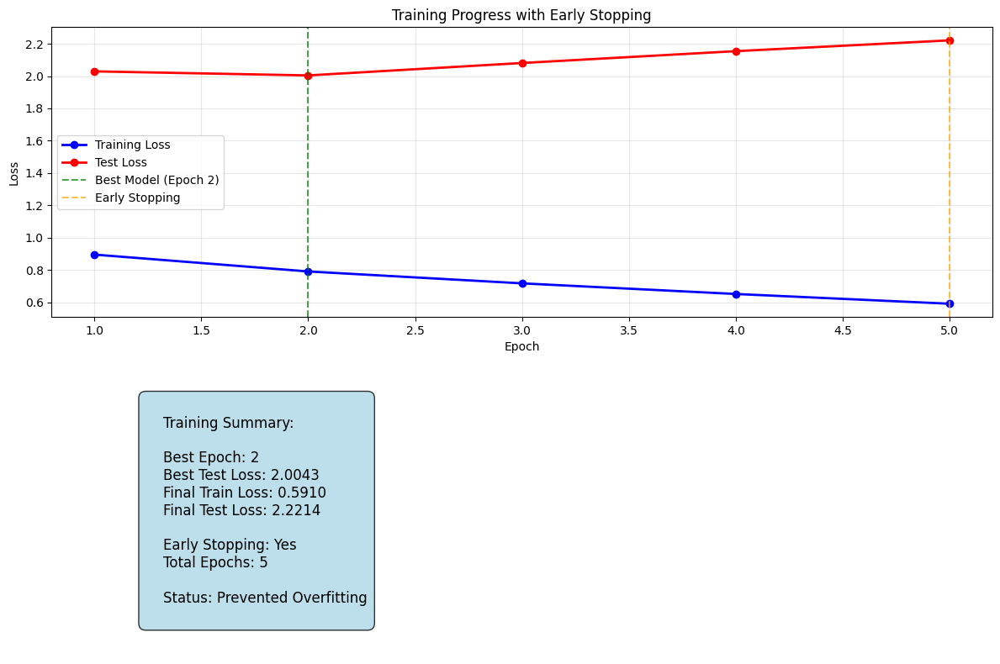

In [ ]:
def train_with_early_stopping():
    """Training loop with early stopping to prevent overfitting"""
    # Early stopping parameters
    best_test_loss = float('inf') # keeps track of the lowest test loss achieved so far during training
    patience = 3  # Wait 3 epochs for improvement->number of epochs the training process will wait for the test loss to improve before stopping
    patience_counter = 0 # counter keeps track of the number of epochs since the last improvement in test loss
    best_epoch = 0 #  stores the epoch number where the best_test_loss was achieved

    for epoch in range(EPOCHS):
        epoch_start = time.time()
        total_loss = 0

        print(f"\n Epoch {epoch+1}/{EPOCHS}")

        # Training phase
        for (batch, (img_tensor, target)) in enumerate(train_dataset):
            batch_loss, t_loss = train_step(img_tensor, target)
            total_loss += t_loss

            # Progress updates
            if batch % 100 == 0:
                print(f'  Batch {batch}: Loss {batch_loss:.4f}')

        # Calculate metrics
        avg_train_loss = total_loss / train_num_steps
        test_loss = test_loss_cal(test_dataset)

        # Store for plotting
        loss_plot.append(avg_train_loss)
        test_loss_plot.append(test_loss)

        # Early stopping logic
        if test_loss < best_test_loss:
            # Improvement
            improvement = best_test_loss - test_loss
            best_test_loss = test_loss
            best_epoch = epoch + 1
            patience_counter = 0

            #Save the best model
            ckpt_manager.save()

            print(f'Test loss improved by {improvement:.4f}')
            print(f'Model saved at epoch {epoch+1}')

        else:
            # No improvement
            patience_counter += 1
            deterioration = test_loss - best_test_loss

            print(f'No improvement (worse by {deterioration:.4f})')
            print(f'Patience: {patience_counter}/{patience}')

        # Display epoch results
        epoch_time = time.time() - epoch_start
        print(f'Epoch {epoch+1} Summary:')
        print(f' Train Loss: {avg_train_loss:.4f}')
        print(f' Test Loss: {test_loss:.4f}')
        print(f' Time: {epoch_time:.1f}s')
        print(f' Best Test Loss: {best_test_loss:.4f} (Epoch {best_epoch})')

        # Check if we should stop
        if patience_counter >= patience:
            print(f'\n EARLY STOPPING TRIGGERED!')
            print(f'  No improvement for {patience} consecutive epochs')
            print(f'  Best model was at epoch {best_epoch}')
            print(f'  Best test loss: {best_test_loss:.4f}')
            break

    else:
        # Training completed all epochs
        print(f'\n Training completed all {EPOCHS} epochs')
        print(f' Best model was at epoch {best_epoch} with test loss {best_test_loss:.4f}')

    # Load the best model
    print(f'\n Loading best model from epoch {best_epoch}...')
    ckpt.restore(ckpt_manager.latest_checkpoint)

    # Plot results
    plot_training_with_early_stopping(loss_plot, test_loss_plot, best_epoch, patience_counter >= patience)

    return {
        'loss_plot': loss_plot,
        'test_loss_plot': test_loss_plot,
        'best_epoch': best_epoch,
        'best_test_loss': best_test_loss,
        'stopped_early': patience_counter >= patience
    }

# Run training with early stopping
training_results = train_with_early_stopping()

Training Results Visualization:

#### NOTE:
* Since there is a difference between the train & test steps ( Presence of teacher forcing), you may observe that the train loss is decreasing while your test loss is not.
* This doesn't mean that the model is overfitting, as we can't compare the train & test results here, as both approach is different.
* Also, if you want to achieve better results you can run it more epochs, but the intent of this capstone is to give you an idea on how to integrate attention mechanism with E-D architecture for images. The intent is not to create the state of art model.

## <font color = red> **Model Evaluation**
1.Define your evaluation function using greedy search

2.Define your evaluation function using beam search ( optional)

3.Test it on a sample data using BLEU score

### <font color = red> **Greedy Search**

In [ ]:
# features_shape = 2048
attention_features_shape = 64

#Evaluation with Greedy search
def evaluate(image):
    # Return types and usage
    # result
    # Example: ['a', 'dog', 'running', 'in', 'park']
    # Usage: Final caption display, text-to-speech

    # attention_plot
    # Full attention array (max_length, 64)
    # Usage: Attention visualization, model interpretability

    # predictions (Raw Logits)
    # Shape: (vocab_size,) - probability distribution over all words
    # Usage: Confidence analysis, alternative word suggestions, debugging

    attention_plot = np.zeros((max_length, attention_features_shape))

    hidden = decoder.init_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0) #process the input image to desired format before extracting features
    img_tensor_val = base_model(temp_input) # Extract features using our feature extraction model
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val) # extract the features by passing the input to encoder

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
    result = []

    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden) # get the output from decoder

        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

        #Greedy search
        predicted_id = tf.argmax(predictions[0]).numpy() #extract the predicted id(embedded value) which carries the max value
        result.append(tokenizer.index_word[predicted_id]) #map the id to the word from tokenizer and append the value to the result list

        if tokenizer.index_word[predicted_id] == '<end>':
            return result, attention_plot,predictions

        dec_input = tf.expand_dims([predicted_id], 0)

    attention_plot = attention_plot[:len(result), :]
    return result, attention_plot,predictions



In [ ]:
def image_attention_map(caption, attention_weights, image_path):
    """
    Plot image and attention maps

    Args:
        caption: List of words in the caption
        attention_weights: Attention weights array (attention_plot)
        image_path: Path to image file
    """
    print(f"\nProcessing: {os.path.basename(image_path)}")

    try:
        # Check if image exists
        if not os.path.exists(image_path):
            print(f"Image not found: {image_path}")
            return False

        # Create figure
        plt.figure(figsize=(15, 6))

        # Show original image
        plt.subplot(1, 2, 1)
        img = Image.open(image_path)
        plt.imshow(img)
        plt.title(f"Input Image\n{os.path.basename(image_path)}", fontsize=12, fontweight='bold')
        plt.axis('off')

        # Show attention map
        plt.subplot(1, 2, 2)

        if attention_weights is not None and attention_weights.size > 0:
            # Average attention across all words and reshape to 8x8 grid
            attention_map = attention_weights.mean(axis=0).reshape(8, 8)

            im = plt.imshow(attention_map, cmap='hot', interpolation='bilinear')
            plt.title("Attention Map", fontsize=12, fontweight='bold')

            # Add colorbar with proper scaling
            cbar = plt.colorbar(im, fraction=0.046, pad=0.04)
            cbar.set_label('Attention Intensity', rotation=270, labelpad=15)
        else:
            plt.text(0.5, 0.5, "No attention data available",
                    ha='center', va='center', fontsize=14,
                    bbox=dict(boxstyle="round,pad=0.5", facecolor="lightgray", alpha=0.8))
            plt.title("Attention Map", fontsize=12, fontweight='bold')

        plt.axis('off')
        plt.tight_layout()
        plt.show()

        return True

    except Exception as e:
        print(f"Exception while creating image and attention maps: {e}")
        return False

In [ ]:
def plot_attention_for_each_word(result, attention_plot, image_path):
    """
    Attention visualization with word-by-word breakdown

    Args:
        result: List of caption words
        attention_plot: Attention weights array (max_length, 64)
        image_path: Path to image file
    """
    print(f"Creating attention for each word")

    try:
        # Load image
        img = np.array(Image.open(image_path))

        # Clean caption (remove special tokens)
        clean_caption = [word for word in result if word not in ['<start>', '<end>', '<unk>', '<pad>']]

        if len(clean_caption) == 0:
            print("No valid words in caption")
            return False

        # Create figure with subplots
        num_words = len(clean_caption)
        cols = min(4, num_words)  # Max 4 columns
        rows = (num_words + cols - 1) // cols  # Calculate rows needed

        plt.figure(figsize=(4*cols, 4*rows + 2))

        # Plot each word's attention
        for i, word in enumerate(clean_caption):
            if i < len(attention_plot):
                plt.subplot(rows, cols, i + 1)

                # Reshape attention to 8x8 grid
                attention_weights = attention_plot[i].reshape(8, 8)

                # Resize attention to match image size for overlay
                attention_resized = np.array(Image.fromarray(attention_weights).resize((224, 224), Image.LANCZOS))

                # Show image
                plt.imshow(img)

                # Overlay attention
                plt.imshow(attention_resized, cmap='jet', alpha=0.6,
                          extent=[0, img.shape[1], img.shape[0], 0])

                plt.title(f"'{word}'", fontsize=12, fontweight='bold')
                plt.axis('off')

        plt.suptitle(f"Word-by-Word Attention: {' '.join(clean_caption)}",
                     fontsize=14, fontweight='bold')
        plt.tight_layout()
        plt.show()

        return True

    except Exception as e:
        print(f"Exception while creating image and attention maps: {e}")
        return False

In [ ]:
def filt_text(text):
    """Remove special tokens from generated text"""
    if not text:
        return ""

    # Special tokens to remove
    special_tokens = ['<start>', '<unk>', '<end>', '<pad>']

    # Handle both string and list input
    if isinstance(text, list):
        words = text
    else:
        words = text.split()

    # Filter out special tokens
    filtered_words = [word for word in words if word not in special_tokens]

    # Join back to string
    clean_text = ' '.join(filtered_words)
    return clean_text.strip()

# Usage examples:
# filt_text("<start> a dog running in park <end>")  returns=> "a dog running in park"
# filt_text(["<start>", "cat", "sleeping", "<end>"])  return=> "cat sleeping"

## <font color = red> **Prediction**

In [ ]:
image_test = path_test.copy()

In [ ]:
def predict_caption_audio(random, autoplay=False, weights=(0.5, 0.5, 0, 0)) :

    cap_test_data = cap_test.copy()
    rid = np.random.randint(0, random)
    test_image = image_test[rid]
    #test_image = './images/413231421_43833a11f5.jpg'
    #real_caption = '<start> black dog is digging in the snow <end>'

    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_test_data[rid] if i not in [0]])
    result, attention_plot, pred_test = evaluate(test_image)
    real_caption=filt_text(real_caption)
    pred_caption=' '.join(result).rsplit(' ', 1)[0]
    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = pred_caption.split()

    score = sentence_bleu(reference, candidate, weights=weights)#set your weights
    print(f"BELU score: {score*100}")
    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', pred_caption)


    # we will make use of Google Text to Speech API (online), which will convert the caption to audio
    filename = f"voice_{int(time.time())}.mp3"
    filepath = os.path.join(audio_output_path, filename)
    os.makedirs(audio_output_path, exist_ok=True)
    speech = gTTS('Predicted Caption : ' + pred_caption, lang = 'en', slow = False)
    # save on directory
    speech.save(filepath)
    # save for local playback
    speech.save('voice.mp3')
    audio_file = 'voice.mp3'

    display(Audio(audio_file, rate = None, autoplay = autoplay))
    # plot_attention_map(result, attention_plot, test_image)
    image_attention_map(result, attention_plot, test_image)

    plot_attention_for_each_word(result, attention_plot, test_image)
    return test_image

**BLEU Score Weights** - Variation and Significance of Weights

The weights control how BLEU score emphasizes different n-gram matches between real and predicted captions.
- **BLEU-1**: Measures unigram precision
- **BLEU-2**: Measures bigram precision  
- **BLEU-3**: Measures trigram precision
- **BLEU-4**: Measures 4-gram precision

**Implementation**:-

(weight for 1-grams (individual words), weight for 2-grams (phrases f 2 words), weight for 3-grams (phrases of 3 words), weight for 4-grams (phrases of 4 words))


1. Word-Focused (Your Current):
weights = (0.35, 0.25, 0, 0)
- Emphasis on individual words
- Good for: Checking if key concepts are captured
- Example: "dog", "running", "field" present
2. Balanced Approach:
weights = (0.25, 0.25, 0.25, 0.25)  
- Equal emphasis
- Good for: Overall caption quality assessment
- Example: Considers both words and phrase structure
3. Phrase-Focused:
weights = (0.1, 0.3, 0.4, 0.2)
- Emphasis on longer phrases
- Good for: Checking grammatical structure
- Example: "black dog", "is running", "in the field"
4. Strict Matching:
weights = (0.1, 0.2, 0.3, 0.4)
- Heavy emphasis on 4-grams
- Good for: Very precise caption matching
- Example: Requires exact phrase matches

**Test**

BELU score: 9.956740282898929e-276
Real Caption: man trying to guide a kit in the desert
Prediction Caption: a man is riding on a sandy hill



Processing: 2664103423_c539f61016.jpg


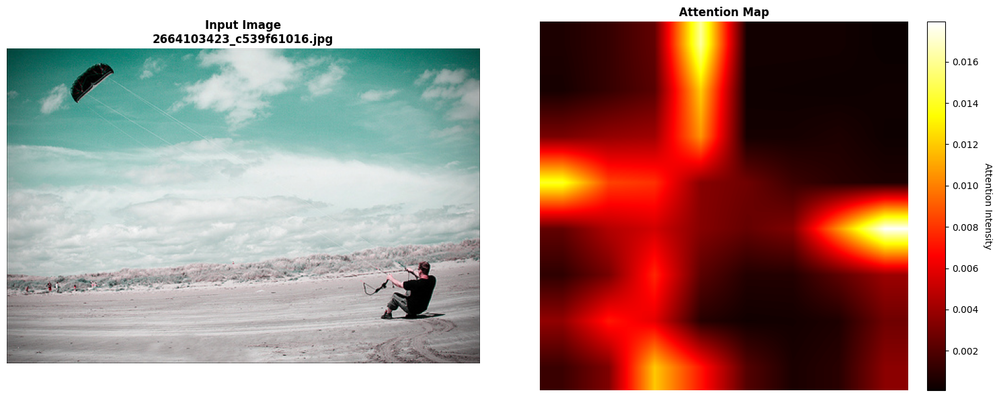

Creating attention for each word


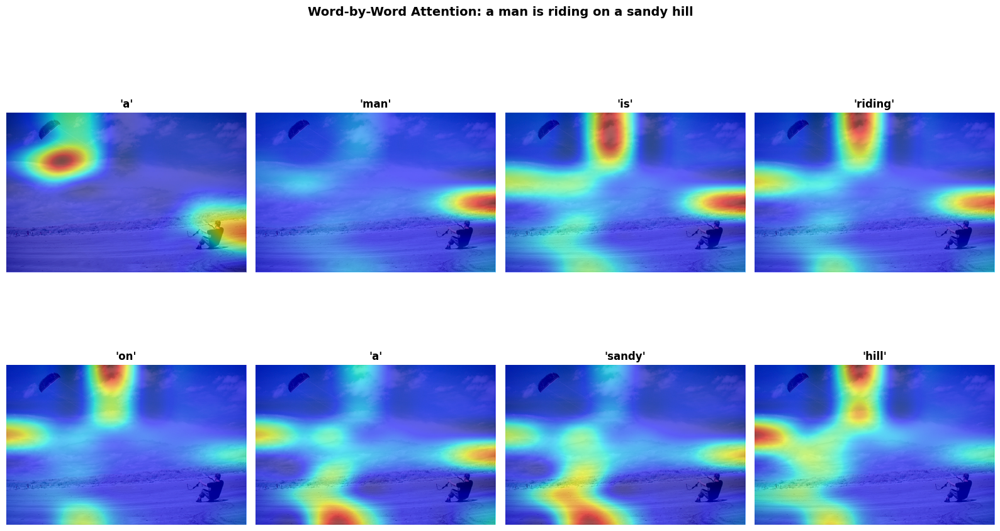

In [ ]:
test_image = predict_caption_audio(len(image_test), True, weights = (0.1, 0.2, 0.3, 0.4))

BELU score: 8.59540728176481e-230
Real Caption: two girls in mid leap , one with jeans and red shirt other with black pants floral shirt
Prediction Caption: a girl in a pink shirt and sandals is jumping over a rope



Processing: 3415287719_3c776f370e.jpg


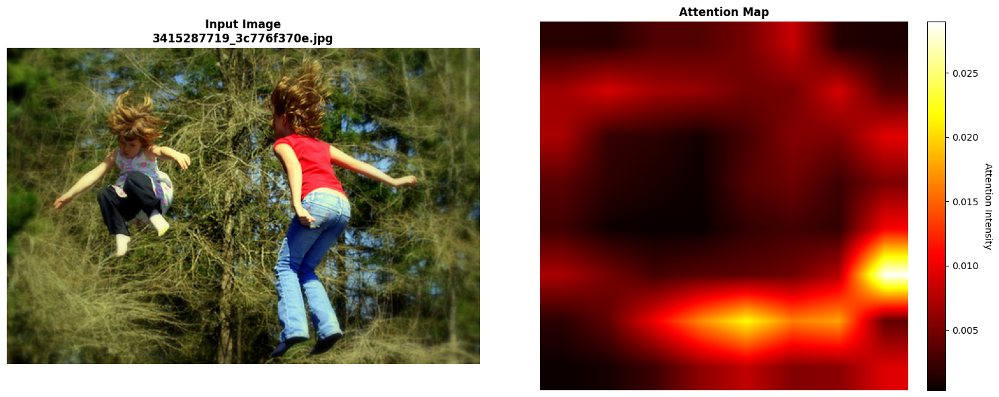

Creating attention for each word


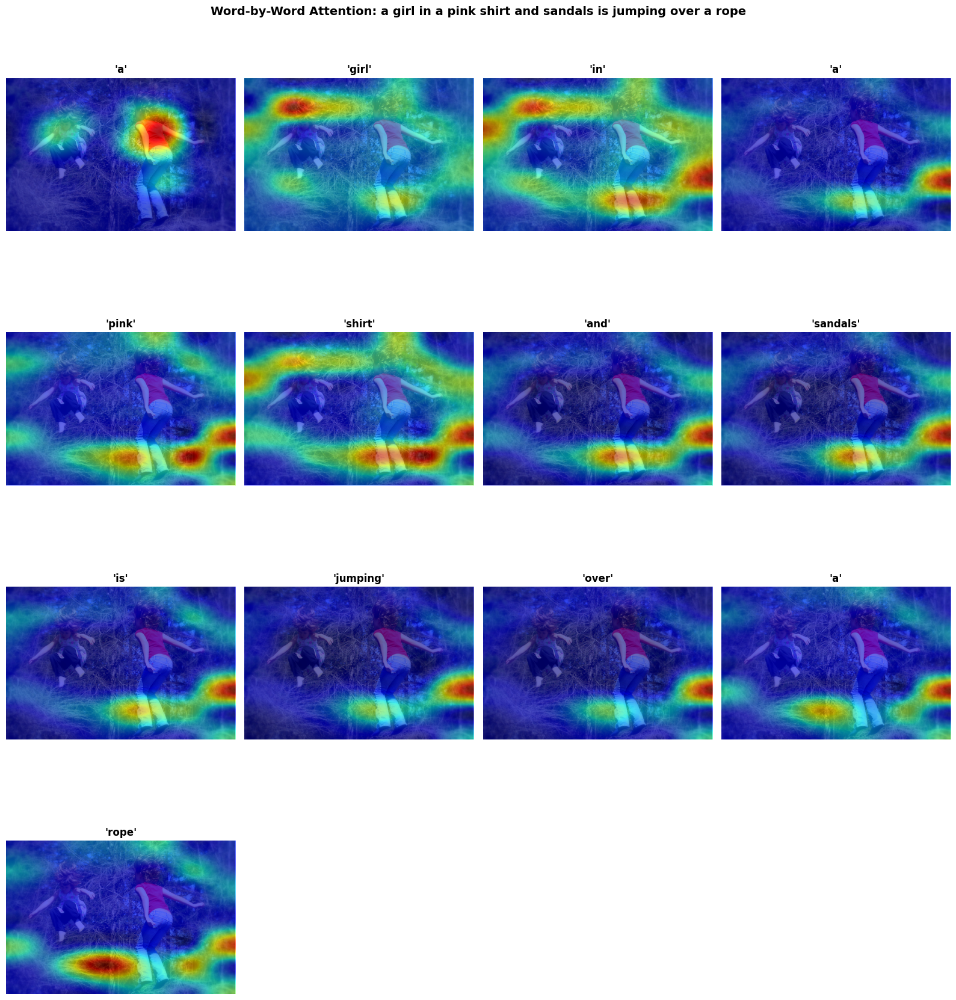

In [ ]:
test_image = predict_caption_audio(len(image_test), True, weights = (0.25, 0.25, 0.25, 0.25))

BELU score: 3.387383998854063e-76
Real Caption: two softball players trying to catch a ball
Prediction Caption: a man in a red shirt and black shorts is holding a football



Processing: 3508637029_89f3bdd3a2.jpg


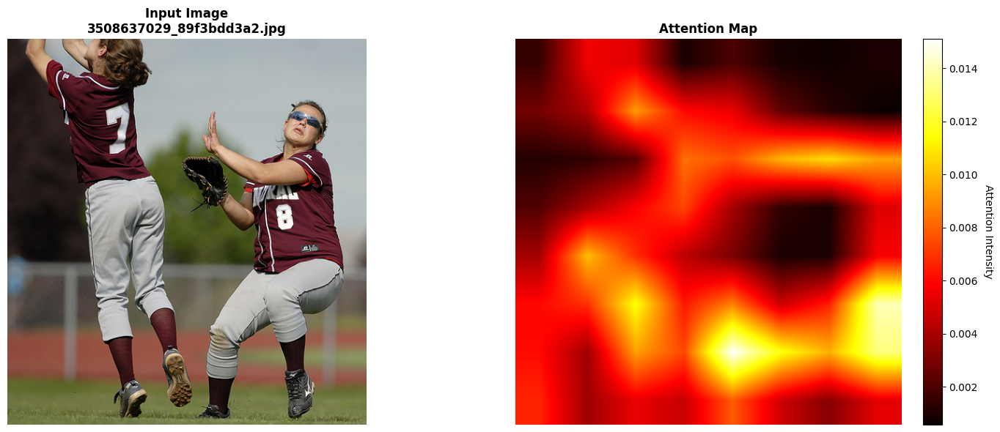

Creating attention for each word


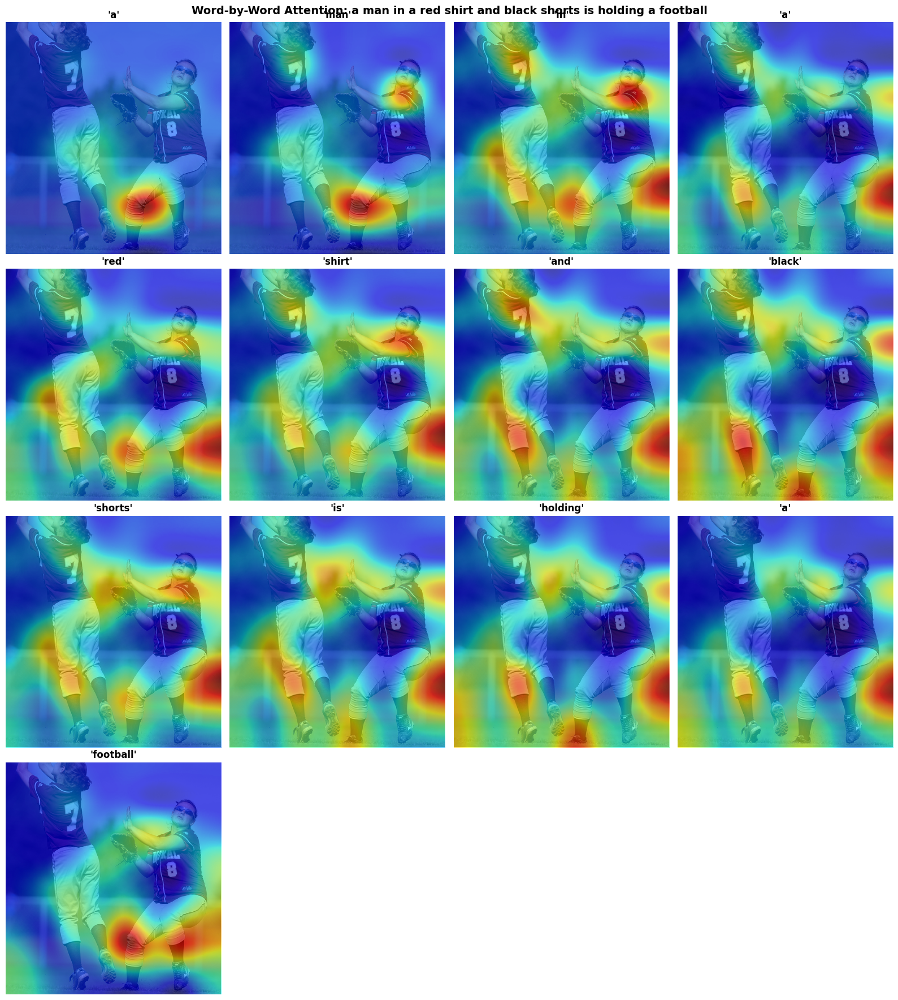

In [ ]:
test_image = predict_caption_audio(len(image_test), True, weights = (0.5, 0.25, 0, 0))

BELU score: 29.80320760201249
Real Caption: a football coach is walking on a football field
Prediction Caption: a man in a red shirt and a clown is holding a football



Processing: 241347611_cb265be138.jpg


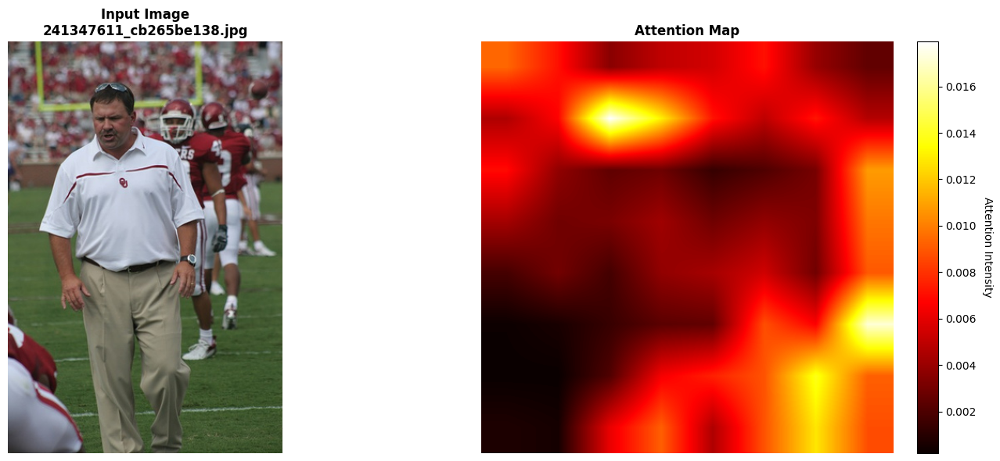

Creating attention for each word


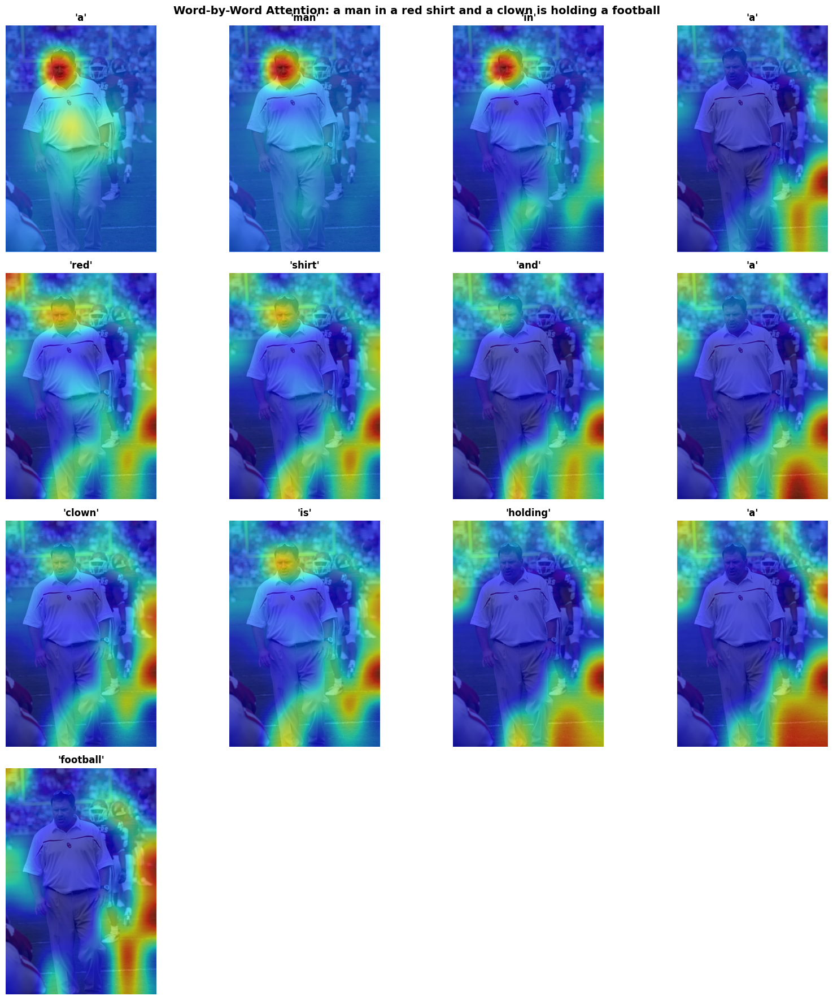

In [ ]:
test_image = predict_caption_audio(len(image_test), True, weights = (0.5, 0.25, 0, 0))

BELU score: 62.791749673479515
Real Caption: a woman in a black shirt is sitting on her feet in a wooden chair
Prediction Caption: a woman in a pink shirt is sitting in a wicker chair



Processing: 2684323357_c7a6d05d05.jpg


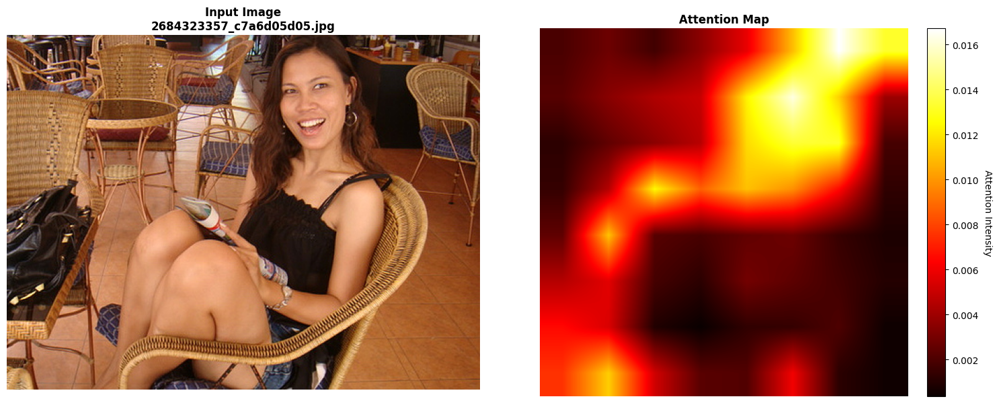

Creating attention for each word


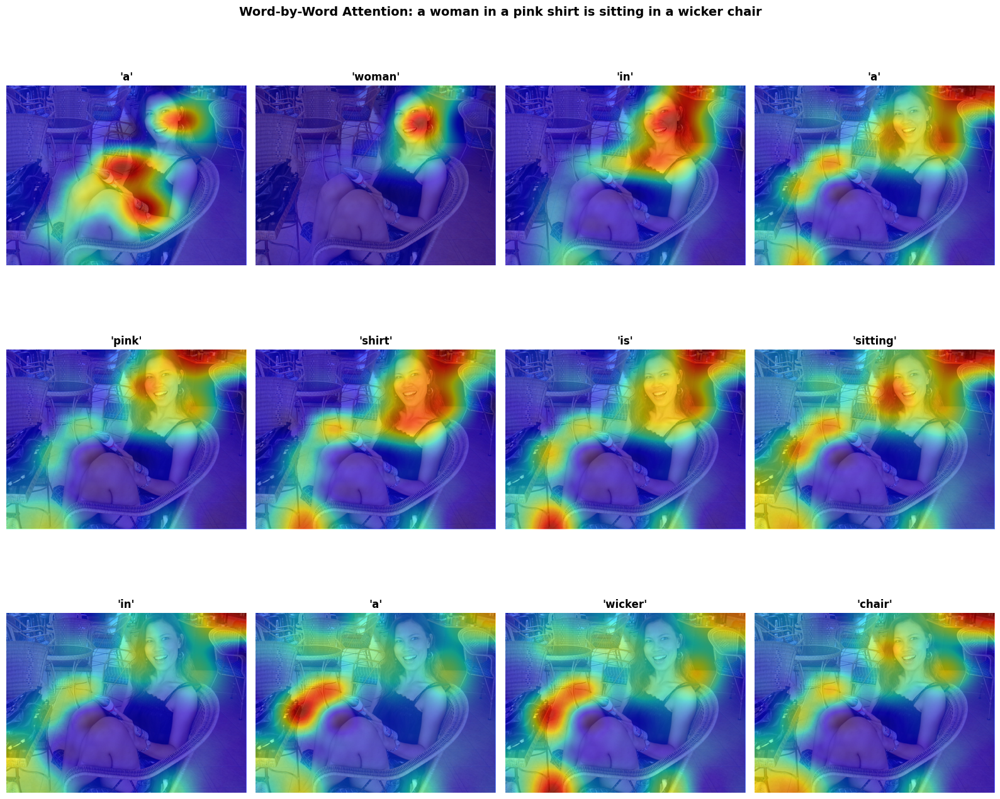

In [ ]:
test_image = predict_caption_audio(len(image_test), True, weights = (0.35, 0.25, 0, 0))

### Beam Search(optional)

## <font color = red> **Result: Project Objective**

As per Evaluation Rubric following objectives needs to be met for completion of project

-	Data preparation
-	Modelling Building
-	Model Evaluation
-	Code readability and conciseness
-	Prediction

**Result: All steps executed successfully and available in Jupyter notebook.**


## <font color = red> **Challenges faced**

-	Compute power for model training.
-	Train and test loss optimization.
-	Model training and handling shape mismatches, symbolic graph errors, or gradient flow issues.


## <font color = red> **Future Improvements**

-	GRU is used as RNN architecture and Bahdanau Attention as attention mechanism.
Model can be trained tested with LSTM RNN architecture and other attention(Dot-product attention
, Luong or Multiplicative Attention) Mechanism and results can be compared for better results.
-	Beam Search is optional scope that can be covered.
